# TF Image Segmentation on Landscape Paintings from Various Art Movements

**AUTHOR: CAMELIA CIOLAC**  
ciolac_c@inria-alumni.fr

In this mini-project we use a pretrained DEEPLAB model with Tensorflow to segment landscape paintings from several Art Movements, automatically highlighting the spatial arrangement of vegetation, water bodies (sea, lake, river), boat, built environment, persons, animals painted in the composition.

Note 1. The paintings are webscraped from WikiArt and we store their metadata  in MongoDB Atlas, temporarily for this demo.

Note 2: We use the model pretrained on ADE20K dataset, which includes classes of interest for this topic.

In [ ]:
from google.colab import drive
drive.mount('/content/gdrive')

Mounted at /content/gdrive


In [ ]:
from IPython.core.display import display, HTML
#display(HTML("<style>.container { width:100% !important; }</style>"))

import matplotlib as mpl
from matplotlib.pyplot import imshow
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec
from matplotlib.patches import Rectangle, Circle
from matplotlib.offsetbox import TextArea, DrawingArea, OffsetImage, AnnotationBbox
from mpl_toolkits import mplot3d

from mpl_toolkits.axes_grid1 import make_axes_locatable
from matplotlib import colors

import seaborn as sns
%matplotlib inline

In [ ]:
!mkdir -p "/content/gdrive/My Drive/landscapes"

In [ ]:
!sudo apt-get install tree > /dev/null 2>&1


#is neded by pyjq
!sudo apt-get install autoconf libtool > /dev/null 2>&1

!pip install pyjq --upgrade

!pip install pymongo[srv] --upgrade

!pip install -q wordcloud

     |████████████████████████████████| 2.0MB 14.6MB/s 
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
    Preparing wheel metadata ... done
  Created wheel for pyjq: filename=pyjq-2.5.1-cp36-cp36m-linux_x86_64.whl size=414324 sha256=b47b408444a4082d81e7080ea5f837b530ea4d873ec01e45daeeca835f8f11a2
  Stored in directory: /root/.cache/pip/wheels/f6/cf/d9/fdba2b07e549628c965297a3e8b8ca5dc846d060cec2545e23
Successfully built pyjq
Requirement already up-to-date: pymongo[srv] in /usr/local/lib/python3.6/dist-packages (3.11.2)
     |████████████████████████████████| 194kB 17.0MB/s 


Restart runtime here on Colab for the setup to take full effect.

In [ ]:
import pandas as pd
import numpy as np
import math
from scipy.spatial import distance

from PIL import Image as pilim
import collections

import pprint
from tabulate import tabulate

import os
import glob
import json
import shutil
import sys

import pyjq

import requests
from bs4 import BeautifulSoup
from io import BytesIO

import pymongo
from bson.son import SON

from wordcloud import WordCloud

import collections as coll

import cv2
cv2.__version__

'4.1.2'

In [ ]:
import os
#logging levels : 0 = INFO , 1 = WARN , 2 = ERROR, 3 = none (not used in TF2)
os.environ['TF_CPP_MIN_LOG_LEVEL'] = '2' 

import tensorflow as tf
from tensorflow.python.lib.io import file_io
import tensorflow_hub as hub
print("TF version:", tf.__version__)

#logging level for TF2
tf.get_logger().setLevel('ERROR')

#devices discovered by TF2
physical_devices = tf.config.list_physical_devices()
for pdev in physical_devices:
  print(pdev)

TF version: 2.4.0
PhysicalDevice(name='/physical_device:CPU:0', device_type='CPU')
PhysicalDevice(name='/physical_device:GPU:0', device_type='GPU')


In [ ]:
#GPU info - NVIDIA System Management Interface
!nvidia-smi 

Sun Jan  3 20:18:54 2021       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 460.27.04    Driver Version: 418.67       CUDA Version: 10.1     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla T4            Off  | 00000000:00:04.0 Off |                    0 |
| N/A   57C    P8    10W /  70W |     10MiB / 15079MiB |      0%      Default |
|                               |                      |                 ERR! |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

In [ ]:
import warnings

with warnings.catch_warnings():
    warnings.filterwarnings("ignore",category=DeprecationWarning)
    warnings.filterwarnings("ignore",category= mpl.cbook.MatplotlibDeprecationWarning)

In [ ]:
def utility_print_lists_columnized(long_list, num_cols_columnize = 5):
    num_columns = num_cols_columnize
    num_rows = int(len(long_list)/num_columns) 

    list_aux = []
    for ii in range(num_rows):
        list_aux.append(long_list[num_columns * ii: num_columns *(ii+1)])

    list_aux.append(long_list[num_columns * num_rows:])

    print(tabulate(list_aux, tablefmt="plain"))

## Collect and store metadata about landscape paintings in MongoDB

In this notebook we use landscape paintings registered in WikiArt. In order to ilustrate with various art movements and techniques (oil, tempera, ), we collect data from a REST API and via webscraping

### Query WikiArt REST API endpoint

In [ ]:
api_endpoint = "https://www.wikiart.org/en/paintings-by-genre/landscape?select=featured&json=2&layout=new&page={}&resultType=masonry"

resp = requests.get(url = api_endpoint.format(1))

print("resp code:", resp.status_code)
resp_json = json.loads(resp.text)
resp_json.keys()

resp code: 200


dict_keys(['ArtistsHtml', 'CanLoadMoreArtists', 'Paintings', 'Artists', 'AllArtistsCount', 'PaintingsHtml', 'PaintingsHtmlBeta', 'AllPaintingsCount', 'PageSize', 'TimeLog'])

In [ ]:
print("number paintings returned on api call:", len(resp_json["Paintings"]), "\n")
resp_json["Paintings"][36]

number paintings returned on api call: 60 



{'albums': None,
 'artistName': 'Sandro Botticelli',
 'artistUrl': '/en/sandro-botticelli',
 'flags': 2,
 'height': 2680,
 'id': '57726e78edc2cb3880b741d8',
 'image': 'https://uploads6.wikiart.org/images/sandro-botticelli/annunciation-cestello-detail-1490(1).jpg',
 'images': None,
 'map': '01234567*',
 'paintingUrl': '/en/sandro-botticelli/annunciation-cestello-detail-1490',
 'title': 'Annunciation\xa0Cestello (detail)',
 'width': 2040,
 'year': '1489-1490'}

In [ ]:
def query_api_page(page_num):
    api_endpoint = "https://www.wikiart.org/en/paintings-by-genre/landscape?select=featured&json=2&layout=new&page={}&resultType=masonry"
    resp = requests.get(url = api_endpoint.format(page_num))
    if resp.status_code == 200:
        resp_json = json.loads(resp.text)
        return resp_json
    else:
        None

In [ ]:
res = query_api_page(1)
assert(len(res["Paintings"]) == 60)

### Webscrap painting metadata 

In [ ]:
FOLDER_IMAGES = "/content/gdrive/My Drive/landscapes/"

This is how the webpage with ainting details looks like:

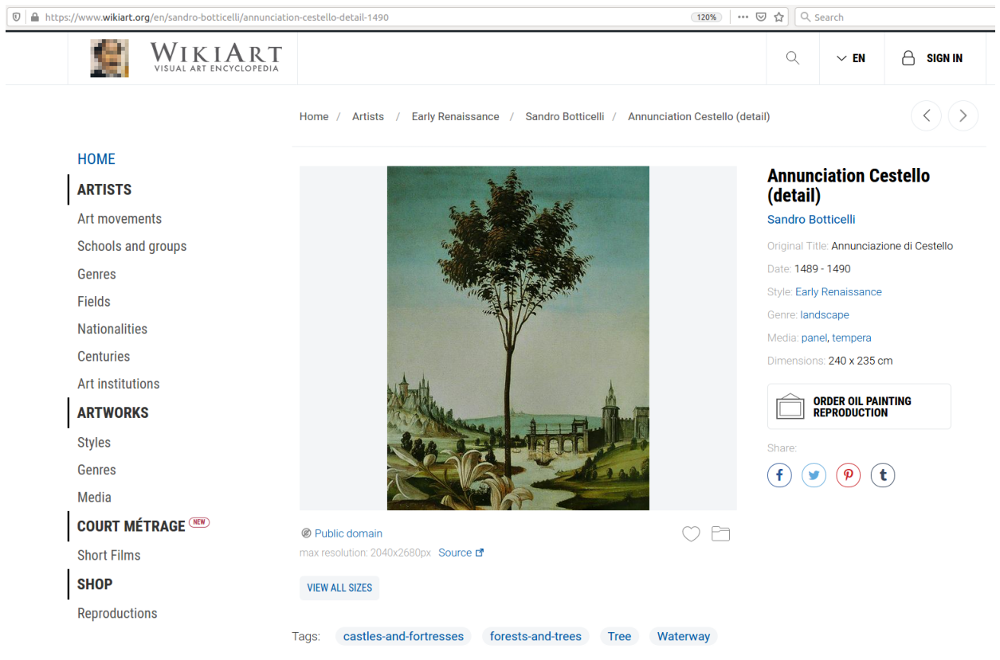

In [ ]:
fig,ax = plt.subplots(1,1, figsize = (30,15))
im = pilim.open(FOLDER_IMAGES + "webpage_painting.png")
ax.imshow(im)
ax.axis("off");

In [ ]:
def get_painting_metadata_wikiart(painting_url, debug_flag = False):
    url_wikiart = "https://www.wikiart.org/" + painting_url

    webpage = requests.get(url_wikiart)

    html_src = webpage.content

    soup = BeautifulSoup(html_src, 'html.parser')

    #select list items by css class 
    li_info = soup.findAll("li", {"class" :"dictionary-values"})

    dict_mappings = {
        "Style:" : "artmovment", #e.g. impressionism
        "Genre:" : "subject",     #e.g. landscape
        "Media:" : "technique"    #e.g. tempera
    }

    dict_metadata = {}

    for li_item in li_info:
        #print(li_item)
        s = li_item.findChildren("s")[0]
        categ = str(s.text).strip() 
        if categ in dict_mappings.keys():
            if debug_flag is True:
                print(li_item)
                print("----------------------------------------------------------------")
            #extract children a href urls
            a_href = li_item.findChildren("a")
            #note: a href="/en/paintings-by-style/early-renaissance" ... we take only  "early-renaissance" from it
            list_wikiartid = [el["href"].split("/")[-1] for el in a_href]
            dict_metadata[dict_mappings[categ]] = list_wikiartid 


    #also collect the tags on image
    dict_metadata["tags"] = []
    a_tags = soup.findAll("a", {"class": "tags-cheaps__item__ref"})
    for a_tag in a_tags:
        if debug_flag is True:
            print("********", a_tag)
        dict_metadata["tags"].append(a_tag["href"].split("/")[-1])


    if debug_flag is True:
        print("===============================================================")

    return dict_metadata



In [ ]:
dict_metadata = get_painting_metadata_wikiart(
                     painting_url = resp_json["Paintings"][36]["paintingUrl"], 
                     debug_flag=True)

dict_metadata

<li class="dictionary-values ">
<s>Style:</s>
<span>
<a href="/en/paintings-by-style/early-renaissance" target="_self">Early Renaissance</a>
</span>
</li>
----------------------------------------------------------------
<li class="dictionary-values ">
<s>Genre:</s>
<span>
<a href="/en/paintings-by-genre/landscape" target="_self"><span itemprop="genre">landscape</span></a>
</span>
</li>
----------------------------------------------------------------
<li class="dictionary-values ">
<s>Media:</s>
<span>
<a href="/en/paintings-by-media/panel" target="_self">panel</a><span>,</span>
<a href="/en/paintings-by-media/tempera" target="_self">tempera</a>
</span>
</li>
----------------------------------------------------------------
******** <a class="tags-cheaps__item__ref" href="/en/tag/castles-and-fortresses" target="_self">
                                    castles-and-fortresses
                                </a>
******** <a class="tags-cheaps__item__ref" href="/en/tag/forests-and-trees"

{'artmovment': ['early-renaissance'],
 'subject': ['landscape'],
 'tags': ['castles-and-fortresses', 'forests-and-trees', 'tree-0', 'waterway'],
 'technique': ['panel', 'tempera']}

In [ ]:
#combine results - this is a doc that will be stored in the collection in a MongoDB database
d = resp_json["Paintings"][36]
d["metadata"] = dict_metadata

pprint.pprint(d)

{'albums': None,
 'artistName': 'Sandro Botticelli',
 'artistUrl': '/en/sandro-botticelli',
 'flags': 2,
 'height': 2680,
 'id': '57726e78edc2cb3880b741d8',
 'image': 'https://uploads6.wikiart.org/images/sandro-botticelli/annunciation-cestello-detail-1490(1).jpg',
 'images': None,
 'map': '01234567*',
 'metadata': {'artmovment': ['early-renaissance'],
              'subject': ['landscape'],
              'tags': ['castles-and-fortresses',
                       'forests-and-trees',
                       'tree-0',
                       'waterway'],
              'technique': ['panel', 'tempera']},
 'paintingUrl': '/en/sandro-botticelli/annunciation-cestello-detail-1490',
 'title': 'Annunciation\xa0Cestello (detail)',
 'width': 2040,
 'year': '1489-1490'}


### Insert into MongoDB Atlas

- create new cluster - We use "Shared Clusters", free. Cloud provider: AWS (eu-central-1)  
see limitations of free tier:  
   https://docs.atlas.mongodb.com/reference/free-shared-limitations   
   https://docs.atlas.mongodb.com/reference/unsupported-commands

- configure which IPs can access the cluster:
    - allow access from anywhere : 0.0.0.0/0
    - config temporary for 1 week

- go to Collections -> load own dataset  - configure:
    - database : paintings
    - collection: landscapes

From central pane (under Metrics section) click Connect to Cluster -> "Connect your application"

In [ ]:
dbname = "paintings"
user = "************"
passw = "**********************************" 

#note: mongodb+srv connections need not contain port, it's determined via DNS lookup
conn_str1 = "mongodb+srv://{}:{}@cluster0.xxuhr.mongodb.net/{}?retryWrites=true&w=majority".format(user, passw, dbname)

#print(conn_str)

mongo_client = pymongo.MongoClient(conn_str1)

In [ ]:
db_ = mongo_client.get_database(dbname)

db_.list_collection_names()

['landscapes']

In [ ]:
#attention!!! removes all documents in the collection
mongo_client.paintings.landscapes.remove({})

In [ ]:
for collection_name in db_.list_collection_names(): 
    collection_ = mongo_client.paintings[collection_name]
    # DeprecationWarning: .count() is deprecated
    num_docs = collection_.estimated_document_count()
    print("Collection: {}||| num docs: {}".format(collection_name.ljust(30), num_docs))

Collection: landscapes                    ||| num docs: 0


In [ ]:
#test add a doc
insert_res = mongo_client.paintings.landscapes.insert_one(d)
obj_id = insert_res.inserted_id
print("Object id:", obj_id, " \n")
utility_print_lists_columnized([el for el in dir(insert_res) if el[0]!="_"])

Object id: 5fef763350c518576f2e6bbf  

acknowledged  inserted_id


In [ ]:
print("Now in collection num docs:", mongo_client.paintings.landscapes.estimated_document_count(), "\n")

#retrieve inserted doc
docs_cursor = mongo_client.paintings.landscapes.find( { "_id": obj_id } )
for doc_ in  docs_cursor:
    pprint.pprint(doc_)

Now in collection num docs: 1 

{'_id': ObjectId('5fef763350c518576f2e6bbf'),
 'albums': None,
 'artistName': 'Sandro Botticelli',
 'artistUrl': '/en/sandro-botticelli',
 'flags': 2,
 'height': 2680,
 'id': '57726e78edc2cb3880b741d8',
 'image': 'https://uploads6.wikiart.org/images/sandro-botticelli/annunciation-cestello-detail-1490(1).jpg',
 'images': None,
 'map': '01234567*',
 'metadata': {'artmovment': ['early-renaissance'],
              'subject': ['landscape'],
              'tags': ['castles-and-fortresses',
                       'forests-and-trees',
                       'tree-0',
                       'waterway'],
              'technique': ['panel', 'tempera']},
 'paintingUrl': '/en/sandro-botticelli/annunciation-cestello-detail-1490',
 'title': 'Annunciation\xa0Cestello (detail)',
 'width': 2040,
 'year': '1489-1490'}


In [ ]:
#delete doc
mongo_client.paintings.landscapes.delete_one( { "_id": obj_id } )

print("Now in collection num docs:", mongo_client.paintings.landscapes.estimated_document_count(), "\n")


Now in collection num docs: 0 



**Now collect data from WikiArt:**

In [ ]:
def orchestrate_data_collection(start_page = 1, end_page = 1, debug_flag = False):
    for page_num in range(start_page, end_page + 1):
        resp_json = query_api_page(page_num)

        if resp_json is not None:
            #webscaping for each entry in resp_json
            list_metadata_docs = []
            if debug_flag is True:
                print("on page {} will process {} entries".format(page_num, len(resp_json["Paintings"])))
            for ii in range(len(resp_json["Paintings"])):
                try:
                    dict_metadata = get_painting_metadata_wikiart(
                                    painting_url = resp_json["Paintings"][ii]["paintingUrl"], 
                                    debug_flag=False)
                    #combine results - this is a doc that will be stored in the collection in a MongoDB database
                    d = resp_json["Paintings"][ii]
                    d["metadata"] = dict_metadata
                    list_metadata_docs.append(d)
                except Exception as e:
                    print(resp_json["Paintings"][ii]["paintingUrl"], " --> ", e)
            #insert array of docs in Mongo Atlas
            insert_res = mongo_client.paintings.landscapes.insert_many(list_metadata_docs)
        else:
            print("page {} has empty json from api endpoint".format(page_num))

In [ ]:
%%time
orchestrate_data_collection(start_page = 1, end_page = 1, debug_flag = True)

on page 1 will process 60 entries
CPU times: user 3.5 s, sys: 40.2 ms, total: 3.54 s
Wall time: 1min 21s


In [ ]:
print("Now in collection num docs:", mongo_client.paintings.landscapes.estimated_document_count(), "\n")

Now in collection num docs: 60 



In [ ]:
orchestrate_data_collection(start_page = 2, end_page = 30)

In [ ]:
orchestrate_data_collection(start_page = 31, end_page = 60)

In [ ]:
print("Now in collection num docs:", mongo_client.paintings.landscapes.estimated_document_count(), "\n")

Now in collection num docs: 3600 



In [ ]:
#get a sample of 3 of the inserted docs
results = mongo_client.paintings.landscapes.aggregate(
    [ { "$sample": { "size": 3 } } ]
)

for doc_ in results:
    pprint.pprint(doc_)

{'_id': ObjectId('5fefa29350c518576f2e75b6'),
 'albums': None,
 'artistName': 'Camille Corot',
 'artistUrl': '/en/camille-corot',
 'flags': 2,
 'height': 989,
 'id': '57727036edc2cb3880bd1cea',
 'image': 'https://uploads4.wikiart.org/images/camille-corot/goatherd-standing-playing-the-flute-under-the-trees-1855.jpg',
 'images': None,
 'map': '01234*67*',
 'metadata': {'artmovment': ['realism'],
              'subject': ['landscape'],
              'tags': ['animals',
                       'lakes-and-ponds',
                       'goats',
                       'forests-and-trees',
                       'tree-0'],
              'technique': ['oil', 'canvas']},
 'paintingUrl': '/en/camille-corot/goatherd-standing-playing-the-flute-under-the-trees-1855',
 'title': 'Goatherd Standing, Playing the Flute under the Trees',
 'width': 660,
 'year': '1850-1855'}
{'_id': ObjectId('5fefa06450c518576f2e742d'),
 'albums': None,
 'artistName': 'Jean-Joseph-Xavier Bidauld',
 'artistUrl': '/en/jean-j

## Analytics on landscape paintings metadata

In [ ]:
dbname = "paintings"
user = "************"
passw = "**********************************" 

#note: mongodb+srv connections need not contain port, it's determined via DNS lookup
conn_str1 = "mongodb+srv://{}:{}@cluster0.xxuhr.mongodb.net/{}?retryWrites=true&w=majority".format(user, passw, dbname)

#print(conn_str)

mongo_client = pymongo.MongoClient(conn_str1)

### List art movements with landscapes

In [ ]:
#note: we need to unwind lists of artmovement and painting technique/media
pipeline = [
            { "$project": 
                { "list_artmovements" : "$metadata.artmovment" }
            },
           {"$unwind": "$list_artmovements"},   
           {"$group": {"_id":  "$list_artmovements",
                       "num": {"$sum": 1}}
            },
            {"$sort": SON([ ("num", -1) ])
            },
            {  "$project":
                {   "the_artmovement" : "$_id",
                    "count"           : "$num",
                    "_id"             : 0      #needs to be explicitly removed from results
                }

            }
 ]

results_cursor = mongo_client.paintings.landscapes.aggregate(pipeline)

In [ ]:
pp = pprint.PrettyPrinter(width=100, compact=False)
pp.pprint(list(results_cursor))

[{'count': 1379, 'the_artmovement': 'romanticism'},
 {'count': 640, 'the_artmovement': 'realism'},
 {'count': 432, 'the_artmovement': 'baroque'},
 {'count': 245, 'the_artmovement': 'ukiyo-e'},
 {'count': 230, 'the_artmovement': 'neoclassicism'},
 {'count': 165, 'the_artmovement': 'rococo'},
 {'count': 111, 'the_artmovement': 'ink-and-wash-painting'},
 {'count': 109, 'the_artmovement': 'northern-renaissance'},
 {'count': 104, 'the_artmovement': 'luminism'},
 {'count': 64, 'the_artmovement': 'impressionism'},
 {'count': 30, 'the_artmovement': 'orientalism'},
 {'count': 25, 'the_artmovement': 'classicism'},
 {'count': 19, 'the_artmovement': 'nanga-bunjinga'},
 {'count': 19, 'the_artmovement': 'yamato-e'},
 {'count': 18, 'the_artmovement': 'na-ve-art-primitivism'},
 {'count': 16, 'the_artmovement': 'symbolism'},
 {'count': 14, 'the_artmovement': 'tonalism'},
 {'count': 10, 'the_artmovement': 'kano-school'},
 {'count': 8, 'the_artmovement': 'mannerism-late-renaissance'},
 {'count': 5, 'the_

### Count paintings groupped by art movement and technique/media

In [ ]:
#note: we need to unwind lists of artmovement and painting technique/media
pipeline = [
            { "$project": 
                { "list_artmovements" : "$metadata.artmovment",
                  "list_techniques" : "$metadata.technique"
                }
            },
           {"$unwind": "$list_artmovements"},  
           {"$unwind": "$list_techniques"},     
           {"$group": {"_id": 
                       {"artmov" : "$list_artmovements",
                        "techq"  : "$list_techniques" },
                       "num": {"$sum": 1}}
            },
            {"$sort": SON([ ("_id.artmov", 1), 
                            ("num", -1) 
                          ])
            },
            {  "$project":
                {   "the_artmovement" : "$_id.artmov",
                    "the_technique"   : "$_id.techq",
                    "count"           : "$num",
                    "_id"             : 0         #needs to be explicitly remove
                }

            }
 ]

results_cursor = mongo_client.paintings.landscapes.aggregate(pipeline)

In [ ]:
df_artmov_techq = pd.DataFrame(list(results_cursor))

df_artmov_techq.head()

,the_artmovement,the_technique,count
0,academicism,oil,1
1,academicism,canvas,1
2,baroque,oil,157
3,baroque,canvas,69
4,baroque,panel,32


In [ ]:
#pivot table
df_artmov_techq_pivoted = pd.pivot_table(df_artmov_techq, 
                                         values = "count", 
                                         index = "the_artmovement",
                                         columns="the_technique",
                                         fill_value = 0)


#filter only columns(i.e. techniques) with sum over 20 
df_artmov_techq_pivoted_filtered_cols = df_artmov_techq_pivoted.loc[:, (df_artmov_techq_pivoted.sum() >= 20) ]

#of the above result, filter rows (i.e. artmovements) with sum over 30
df_artmov_techq_pivoted_filtered_rows = df_artmov_techq_pivoted_filtered_cols[df_artmov_techq_pivoted_filtered_cols.sum(axis=1)>30]

df_artmov_techq_pivoted_filtered_rows

the_technique,canvas,color-woodblock-print,etching,ink,oil,panel,paper,watercolor,woodcut
the_artmovement,,,,,,,,,
baroque,69,0,29,6,157,32,9,7,1
classicism,22,0,0,0,23,0,0,0,0
impressionism,18,0,0,0,23,1,0,1,0
luminism,47,0,0,0,68,2,11,0,0
neoclassicism,46,0,1,0,98,0,3,2,0
northern-renaissance,5,0,43,6,23,14,15,9,0
realism,292,0,1,2,384,31,35,5,0
rococo,39,0,0,0,40,0,6,0,0
romanticism,365,0,0,3,460,13,103,88,0


### Wordcloud of tags associated with paintings

In [ ]:
pipeline = [
            { "$project": 
                { "tags" : "$metadata.tags" }
            },
           {"$unwind": "$tags"},   
           {"$group": {"_id": "$tags",
                       "num": {"$sum": 1}}
            },
            {"$sort": SON([ ("num", -1) ])
            },
            {  "$project":
                {   "the_tag" : "$_id",
                    "count"   : "$num",
                    "_id"     : 0          #need to explicitly hide _id 
                }
            }
 ]

results_cursor = mongo_client.paintings.landscapes.aggregate(pipeline)

In [ ]:
df_results = pd.DataFrame(list(results_cursor))

#display transposed
df_results.head(25).T

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24
the_tag,sky-0,tree-0,natural-landscape,forests-and-trees,nature-0,mountains,atmospheric-phenomenon,morning,cloud,bank,mountain,rivers-and-waterfalls,atmosphere,woody-plant,cliffs-and-rocks,water-0,natural-environment,rural-area,rock,boats-and-ships,mountainous-landforms,plant,highland,hill,seas-and-oceans
count,1615,1333,891,660,606,391,374,368,329,305,293,288,276,232,213,209,206,206,204,181,177,176,170,166,152


In [ ]:
help( WordCloud.__init__)

Help on function __init__ in module wordcloud.wordcloud:

__init__(self, font_path=None, width=400, height=200, margin=2, ranks_only=None, prefer_horizontal=0.9, mask=None, scale=1, color_func=None, max_words=200, min_font_size=4, stopwords=None, random_state=None, background_color='black', max_font_size=None, font_step=1, mode='RGB', relative_scaling='auto', regexp=None, collocations=True, colormap=None, normalize_plurals=True, contour_width=0, contour_color='black', repeat=False)
    Initialize self.  See help(type(self)) for accurate signature.



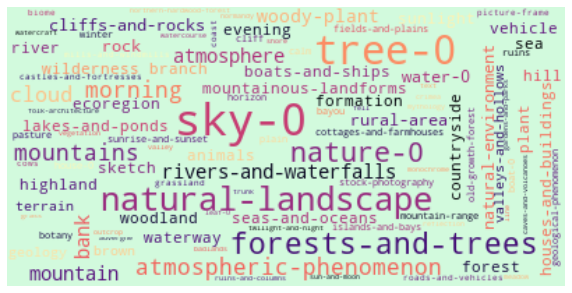

In [ ]:
dict_freq = dict(zip(df_results["the_tag"], df_results["count"]))

wc = WordCloud(background_color=(210, 250, 221), colormap="magma",
               max_font_size=32, max_words=100)
wc.generate_from_frequencies(dict_freq)

# show
fig, ax = plt.subplots(1, 1, figsize = (10,10))
ax.imshow(wc, interpolation="bilinear")
ax.axis("off");

### Frequent pairs of tags

In [ ]:
#sidenote - how it works when we unwind two arrays of a doc (more precisely the same array twice)
pipeline = [
            { "$project": 
                { "tags1" : "$metadata.tags",
                  "tags2" : "$metadata.tags",
                }
            },
            #unwind the array twice
           {"$unwind": "$tags1" },
           {"$unwind": "$tags2" }, 
           
            {  "$project":
                {   "tag1" : "$tags1",
                    "tag2" : "$tags2",
                    "_id"     : 1        
                }
            }
 ]

results_cursor = mongo_client.paintings.landscapes.aggregate(pipeline)

pp = pprint.PrettyPrinter(width=100, compact=False)
pp.pprint(list(results_cursor)[0:10])

[{'_id': ObjectId('5fef76ad50c518576f2e6bc0'), 'tag1': 'bird', 'tag2': 'bird'},
 {'_id': ObjectId('5fef76ad50c518576f2e6bc0'), 'tag1': 'bird', 'tag2': 'pattern'},
 {'_id': ObjectId('5fef76ad50c518576f2e6bc0'), 'tag1': 'pattern', 'tag2': 'bird'},
 {'_id': ObjectId('5fef76ad50c518576f2e6bc0'), 'tag1': 'pattern', 'tag2': 'pattern'},
 {'_id': ObjectId('5fef76ad50c518576f2e6bc1'), 'tag1': 'organism', 'tag2': 'organism'},
 {'_id': ObjectId('5fef76ad50c518576f2e6bc2'), 'tag1': 'bird', 'tag2': 'bird'},
 {'_id': ObjectId('5fef76ad50c518576f2e6bc2'), 'tag1': 'bird', 'tag2': 'textile'},
 {'_id': ObjectId('5fef76ad50c518576f2e6bc2'), 'tag1': 'textile', 'tag2': 'bird'},
 {'_id': ObjectId('5fef76ad50c518576f2e6bc2'), 'tag1': 'textile', 'tag2': 'textile'},
 {'_id': ObjectId('5fef76ad50c518576f2e6bc4'), 'tag1': 'tree-0', 'tag2': 'tree-0'}]


In [ ]:
pipeline = [
            { "$project": 
                { "tags1" : "$metadata.tags",
                  "tags2" : "$metadata.tags",
                }
            },
            #unwind the array twice
           {"$unwind": "$tags1" },
           {"$unwind": "$tags2" }, 
           {  "$project":
                {   "tag1" : "$tags1",
                    "tag2" : "$tags2",
                    "_id"     : 1 
                }
           },  
           #to prevent (a,b) and (b,a) , filter so that a > b
            #don't forget to carry along the other fields too in project
           {"$project": 
                       { "ab": {"$cmp": ["$tag1","$tag2"]},
                         "tag1" : "$tag1",
                         "tag2" : "$tag2",
                         "_id"     : 1
                       }
           }, 
           {"$match": 
                      {"ab": {"$gt": 0} }
           },
           #now count groupped by pair of tags 
           {"$group": {"_id": 
                            { "tag1" : "$tag1",
                              "tag2" : "$tag2"
                            },
                       "num": {"$sum": 1}}
            },
            {"$sort": SON([ ("num", -1) ])
            },
            {  "$project":
                {   "tag1" : "$_id.tag1",
                    "tag2" : "$_id.tag2",
                    "count" : "$num",
                    "_id"     : 0          #need to explicitly hide _id 
                }
            }
 ]

results_cursor = mongo_client.paintings.landscapes.aggregate(pipeline)

In [ ]:
list_docs_res = []
for doc_ in results_cursor:
    list_docs_res.append([doc_["tag1"], 
                          doc_["tag2"], 
                          doc_["count"]])

#list only first 20 entries
print(tabulate(list_docs_res[0:20], headers=["tag1", "tag2", "num"], tablefmt="fancy_grid"))

╒═══════════════════╤════════════════════════╤═══════╕
│ tag1              │ tag2                   │   num │
╞═══════════════════╪════════════════════════╪═══════╡
│ tree-0            │ sky-0                  │   638 │
├───────────────────┼────────────────────────┼───────┤
│ sky-0             │ natural-landscape      │   612 │
├───────────────────┼────────────────────────┼───────┤
│ tree-0            │ natural-landscape      │   555 │
├───────────────────┼────────────────────────┼───────┤
│ nature-0          │ natural-landscape      │   514 │
├───────────────────┼────────────────────────┼───────┤
│ tree-0            │ forests-and-trees      │   427 │
├───────────────────┼────────────────────────┼───────┤
│ sky-0             │ nature-0               │   424 │
├───────────────────┼────────────────────────┼───────┤
│ tree-0            │ nature-0               │   356 │
├───────────────────┼────────────────────────┼───────┤
│ sky-0             │ forests-and-trees      │   342 │
├─────────

In [ ]:
#make dataframe and filter by tag1
df_freq_pairs = pd.DataFrame(list_docs_res, columns=["tag1", "tag2", "num"])
df_freq_pairs[((df_freq_pairs["tag1"] == "boats-and-ships") | (df_freq_pairs["tag2"] == "boats-and-ships")) & (df_freq_pairs["num"]>10)]

,tag1,tag2,num
72,sky-0,boats-and-ships,97
94,seas-and-oceans,boats-and-ships,82
163,mountains,boats-and-ships,54
170,vehicle,boats-and-ships,51
195,boats-and-ships,boat-0,45
226,rivers-and-waterfalls,boats-and-ships,39
258,calm,boats-and-ships,35
276,forests-and-trees,boats-and-ships,33
319,boats-and-ships,atmospheric-phenomenon,29
351,morning,boats-and-ships,26


### Sample paintings filtered by criteria

In [ ]:
def get_sample_images(artmovement = None, technique = None, 
                      list_tags = [], sample_size=3, debug_flag = False):
    """ Query MongoDB collection for paintings of a given artmovement and technique,
        with the specified input tags among the artwork's tags 
    """

    #we dynamically compose the pipeline, based on the inputs that are provided to the function
    list_filters = []

    if artmovement is not None:
        filter_artmov = {"metadata.artmovment" : {"$in" : [artmovement]}}
        list_filters.append(filter_artmov)

    if technique is not None:
        filter_techq = {"metadata.technique" : {"$in" : [technique]}}
        list_filters.append(filter_techq)

    if len(list_tags) > 0:
        filter_tags = { "metadata.tags" : { "$all" : list_tags }}
        list_filters.append(filter_tags)

    if len(list_filters) >= 2:
        #we need to use "and" operator
        pipeline_stage_1 = { "$match": {"$and": list_filters} }
    else:
        pipeline_stage_1 = { "$match": list_filters[0] }

    pipeline_stage_2 = { "$sample": { "size": sample_size } }

    pipeline = [pipeline_stage_1, pipeline_stage_2 ]

    if debug_flag is True:
        print("The query pipeline:")
        pprint.pprint(pipeline)
        print("========================================================")

    results_cursor = mongo_client.paintings.landscapes.aggregate(pipeline)
    df_results = pd.DataFrame(list(results_cursor))

    return df_results

In [ ]:
df_results1 =  get_sample_images( artmovement="romanticism", technique="canvas",
                                 list_tags = ["horses", "animals"], 
                                 sample_size=3, debug_flag = True)

df_results1

The query pipeline:
[{'$match': {'$and': [{'metadata.artmovment': {'$in': ['romanticism']}},
                      {'metadata.technique': {'$in': ['canvas']}},
                      {'metadata.tags': {'$all': ['horses', 'animals']}}]}},
 {'$sample': {'size': 3}}]


,_id,id,title,year,width,height,artistName,image,map,paintingUrl,artistUrl,albums,flags,images,metadata
0,5fef7e5a50c518576f2e70bb,57726edbedc2cb3880b89d6c,The White Horse,1819,800,592,John Constable,https://uploads5.wikiart.org/images/john-const...,0123**67*,/en/john-constable/the-white-horse-1819,/en/john-constable,None,2,None,"{'artmovment': ['romanticism'], 'subject': ['l..."
1,5fef7e0950c518576f2e70a2,57726ed9edc2cb3880b89998,Flatford Mill,1817,2024,1656,John Constable,https://uploads3.wikiart.org/images/john-const...,01234567*,/en/john-constable/flatford-mill-1817,/en/john-constable,None,2,"[{'width': 2620, 'height': 2090, 'image': 'htt...","{'artmovment': ['romanticism'], 'subject': ['l..."


### Collect images

In [ ]:
FOLDER_IMAGES = "/content/gdrive/My Drive/landscapes/"

In [ ]:
def download_image(url_im, target_filepath):
    response = requests.get(url_im, stream=True)
    with open(target_filepath, 'wb') as f:
        shutil.copyfileobj(response.raw, f)
    del response

In [ ]:
def collect_and_visualize_paintings(df_results):
    fig, ax = plt.subplots(1, df_results.shape[0], figsize=(30,10) )

    k = 0
    for i,row in df_results.iterrows():
        target_filepath = FOLDER_IMAGES + row["id"] + ".jpg"
        download_image(url_im = row["image"] , target_filepath = target_filepath)
        im  = pilim.open(target_filepath)
        ax[k].imshow(np.array(im))
        ax[k].set_title(row["id"])
        k += 1

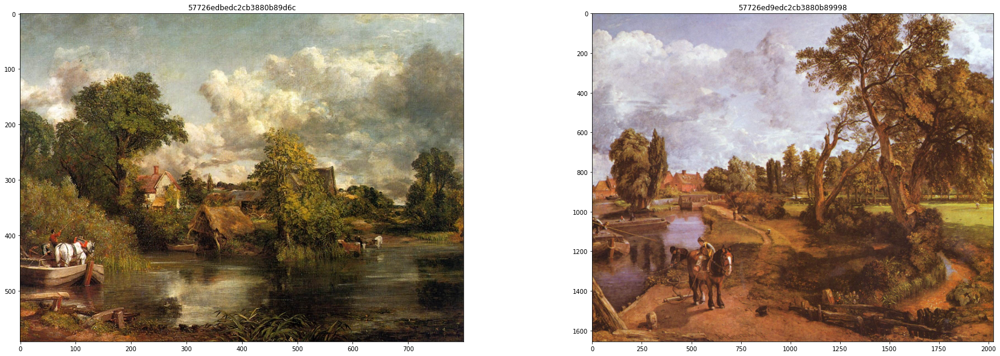

In [ ]:
collect_and_visualize_paintings(df_results1)

In [ ]:
df_results2 =  get_sample_images(artmovement = "northern-renaissance", technique = "panel", 
                                 list_tags = [], 
                                 sample_size=3, debug_flag = True)

df_results2

The query pipeline:
[{'$match': {'$and': [{'metadata.artmovment': {'$in': ['northern-renaissance']}},
                      {'metadata.technique': {'$in': ['panel']}}]}},
 {'$sample': {'size': 3}}]


,_id,id,title,year,width,height,artistName,image,map,paintingUrl,artistUrl,albums,flags,images,metadata
0,5fef786750c518576f2e6c4b,580f3987edc2c98268967107,The Harvesters (July–August),1565,5920,4360,Pieter Bruegel the Elder,https://uploads1.wikiart.org/00103/images/piet...,01234567*,/en/pieter-bruegel-the-elder/the-harvesters-ju...,/en/pieter-bruegel-the-elder,None,2,"[{'width': 1920, 'height': 1398, 'image': 'htt...","{'artmovment': ['northern-renaissance'], 'subj..."
1,5fef781450c518576f2e6c0b,57727d75edc2cb3880e7ccde,Landscape with the Flight into Egypt,1515,2352,1910,Joachim Patinir,https://uploads8.wikiart.org/00311/images/joac...,01234567*,/en/joachim-patinir/landscape-with-the-flight-...,/en/joachim-patinir,None,2,"[{'width': 2024, 'height': 1624, 'image': 'htt...","{'artmovment': ['northern-renaissance'], 'subj..."
2,5fef781450c518576f2e6c23,57726e41edc2cb3880b692cf,Landscape with Christ Appearing to the Apostle...,1553,1305,900,Pieter Bruegel the Elder,https://uploads3.wikiart.org/00102/images/piet...,01234*67*,/en/pieter-bruegel-the-elder/landscape-with-ch...,/en/pieter-bruegel-the-elder,None,2,None,"{'artmovment': ['northern-renaissance'], 'subj..."


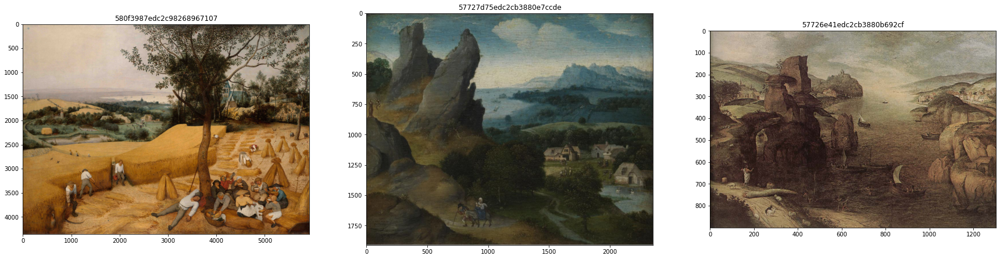

In [ ]:
collect_and_visualize_paintings(df_results2)

In [ ]:
df_results3 =  get_sample_images(artmovement = "romanticism", technique = "watercolor", 
                                 list_tags = ["boats-and-ships"], 
                                 sample_size=3, debug_flag = True)

df_results3

The query pipeline:
[{'$match': {'$and': [{'metadata.artmovment': {'$in': ['romanticism']}},
                      {'metadata.technique': {'$in': ['watercolor']}},
                      {'metadata.tags': {'$all': ['boats-and-ships']}}]}},
 {'$sample': {'size': 3}}]


,_id,id,title,year,width,height,artistName,image,map,paintingUrl,artistUrl,albums,flags,images,metadata
0,5fefa1f250c518576f2e7539,57727706edc2cb3880d345b7,Whitby,XVIII-XIX cent.,1952,1204,J.M.W. Turner,https://uploads0.wikiart.org/images/william-tu...,01234567*,/en/william-turner/whitby,/en/william-turner,None,2,None,"{'artmovment': ['romanticism'], 'subject': ['l..."
1,5fef7f9c50c518576f2e71ba,57727706edc2cb3880d34557,Virginia Water,1829,1106,729,J.M.W. Turner,https://uploads8.wikiart.org/images/william-tu...,0123**67*,/en/william-turner/virginia-water,/en/william-turner,None,2,None,"{'artmovment': ['romanticism'], 'subject': ['l..."
2,5fef7eaa50c518576f2e7110,57727ddfedc2cb3880e913dd,View from the Terrace of the Elagin Palace,1823,741,495,Maxim Vorobiev,https://uploads5.wikiart.org/images/maxim-voro...,0*23**67*,/en/maxim-vorobiev/view-from-the-terrace-of-th...,/en/maxim-vorobiev,None,2,None,"{'artmovment': ['romanticism'], 'subject': ['l..."


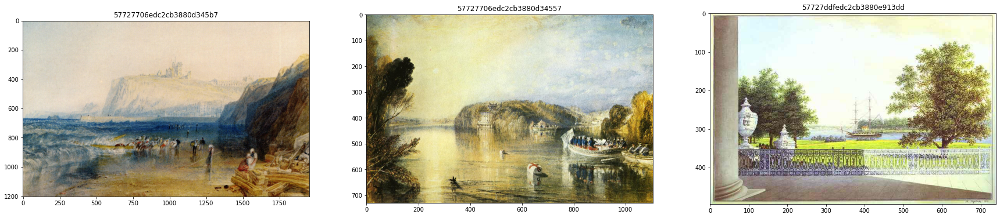

In [ ]:
collect_and_visualize_paintings(df_results3)

In [ ]:
df_results4 =  get_sample_images(artmovement = "impressionism", 
                                 list_tags = [], 
                                 sample_size=3, debug_flag = True)

df_results4

The query pipeline:
[{'$match': {'metadata.artmovment': {'$in': ['impressionism']}}},
 {'$sample': {'size': 3}}]


,_id,id,title,year,width,height,artistName,image,map,paintingUrl,artistUrl,albums,flags,images,metadata
0,5fefa79b50c518576f2e7984,57727aabedc2cb3880df2ec9,The Terrace at Méric (Oleander),1867,1158,694,Frederic Bazille,https://uploads7.wikiart.org/images/frederic-b...,0123**67*,/en/frederic-bazille/the-terrace-at-m-ric-olea...,/en/frederic-bazille,None,2,None,"{'artmovment': ['impressionism'], 'subject': [..."
1,5fefa79b50c518576f2e7964,57727236edc2cb3880c43974,"Sainte-Adresse, Fishing Boats on the Shore",1867,1280,892,Claude Monet,https://uploads6.wikiart.org/images/claude-mon...,01234*67*,/en/claude-monet/sainte-adresse-fishing-boats-...,/en/claude-monet,None,2,None,"{'artmovment': ['impressionism'], 'subject': [..."
2,5fefa60750c518576f2e784f,57727248edc2cb3880c4b01a,The Pointe of Heve,1864,2280,1248,Claude Monet,https://uploads6.wikiart.org/images/claude-mon...,01234567*,/en/claude-monet/the-pointe-of-heve-1864,/en/claude-monet,None,2,None,"{'artmovment': ['impressionism'], 'subject': [..."


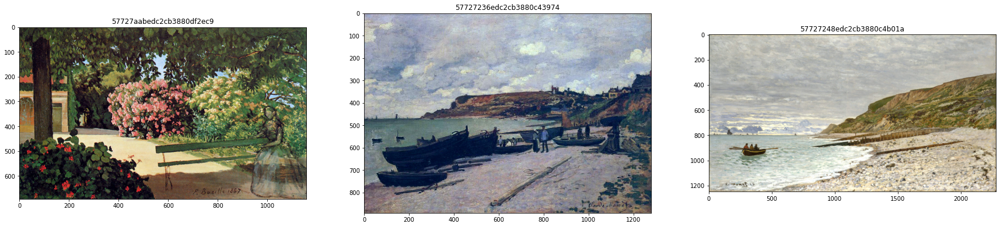

In [ ]:
collect_and_visualize_paintings(df_results4)

In [ ]:
df_results5 =  get_sample_images(artmovement = "baroque", technique = "oil", 
                                 list_tags = [], sample_size=3, debug_flag = True)

df_results5

The query pipeline:
[{'$match': {'$and': [{'metadata.artmovment': {'$in': ['baroque']}},
                      {'metadata.technique': {'$in': ['oil']}}]}},
 {'$sample': {'size': 3}}]


,_id,id,title,year,width,height,artistName,image,map,paintingUrl,artistUrl,albums,flags,images,metadata
0,5fef790750c518576f2e6cc5,59296384edc2c99bdc332beb,Winter,1625,800,794,Jan van Goyen,https://uploads7.wikiart.org/00134/images/jan-...,0123**67*,/en/jan-van-goyen/winter-1625,/en/jan-van-goyen,None,2,None,"{'artmovment': ['baroque'], 'subject': ['panor..."
1,5fef790750c518576f2e6cb6,5b054aeaedc2c926a8f5e43f,Winter Landscape with a Frozen River and Figures,1620,1749,1071,Hendrick Avercamp,https://uploads3.wikiart.org/00185/images/hend...,01234*67*,/en/hendrick-avercamp/winter-landscape-with-a-...,/en/hendrick-avercamp,None,2,None,"{'artmovment': ['baroque'], 'subject': ['lands..."
2,5fef795850c518576f2e6d09,57727a9bedc2cb3880df1a4d,Twilight Landscape,1635,1179,770,Adriaen Brouwer,https://uploads4.wikiart.org/images/adriaen-br...,0123**67*,/en/adriaen-brouwer/twilight-landscape,/en/adriaen-brouwer,None,2,None,"{'artmovment': ['baroque'], 'subject': ['lands..."


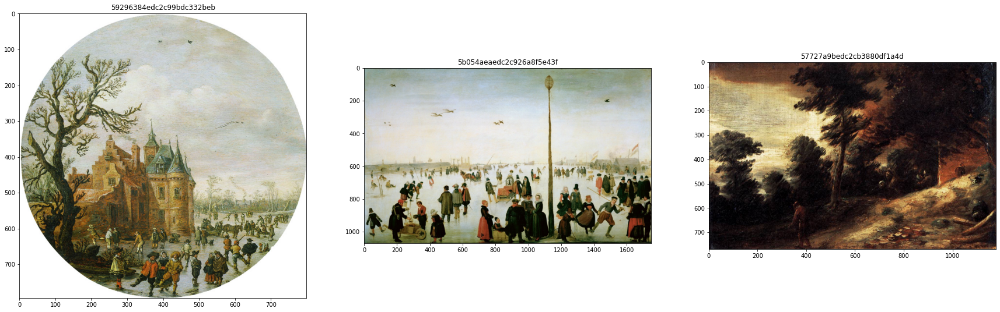

In [ ]:
collect_and_visualize_paintings(df_results5)

In [ ]:
df_results6 =  get_sample_images(artmovement = "ukiyo-e", technique = "color-woodblock-print", 
                                 list_tags = [], sample_size=5, debug_flag = True)

df_results6

The query pipeline:
[{'$match': {'$and': [{'metadata.artmovment': {'$in': ['ukiyo-e']}},
                      {'metadata.technique': {'$in': ['color-woodblock-print']}}]}},
 {'$sample': {'size': 5}}]


,_id,id,title,year,width,height,artistName,image,map,paintingUrl,artistUrl,albums,flags,images,metadata
0,5fefa38050c518576f2e7678,5f312f22edc2c9c9108221cd,91. In the Akiba Shrine at Ukeji,1857,591,899,Hiroshige,https://uploads7.wikiart.org/00301/images/hiro...,01234*67*,/en/hiroshige/91-in-the-akiba-shrine-at-ukeji-...,/en/hiroshige,None,2,None,"{'artmovment': ['ukiyo-e'], 'subject': ['lands..."
1,5fefa3d050c518576f2e768b,5f313dffedc2c9c910f35a88,104. Koume Embankment,1857,594,900,Hiroshige,https://uploads7.wikiart.org/00301/images/hiro...,01234*67*,/en/hiroshige/104-koume-embankment-1857,/en/hiroshige,None,2,None,"{'artmovment': ['ukiyo-e'], 'subject': ['lands..."
2,5fefa33150c518576f2e7637,5f310fd6edc2c9c9109f8438,15. Suwa Bluff in Nippori,1857,793,1200,Hiroshige,https://uploads0.wikiart.org/00301/images/hiro...,01234567*,/en/hiroshige/15-suwa-bluff-in-nippori-1857,/en/hiroshige,None,2,None,"{'artmovment': ['ukiyo-e'], 'subject': ['lands..."
3,5fefa38050c518576f2e7685,5f313dffedc2c9c910f35a7c,"102. Minowa, Kanasugi and Mikawashima",1857,598,898,Hiroshige,https://uploads2.wikiart.org/00301/images/hiro...,01234*67*,/en/hiroshige/102-minowa-kanasugi-and-mikawash...,/en/hiroshige,None,2,None,"{'artmovment': ['ukiyo-e'], 'subject': ['lands..."
4,5fefa42250c518576f2e76f9,5f311ed0edc2c9c910069b14,71 (61) Scattered Pines on the Tone River,XVIII-XIX cent.,786,1200,Hiroshige,https://uploads6.wikiart.org/00301/images/hiro...,01234567*,/en/hiroshige/71-61-scattered-pines-on-the-ton...,/en/hiroshige,None,2,None,"{'artmovment': ['ukiyo-e'], 'subject': ['lands..."


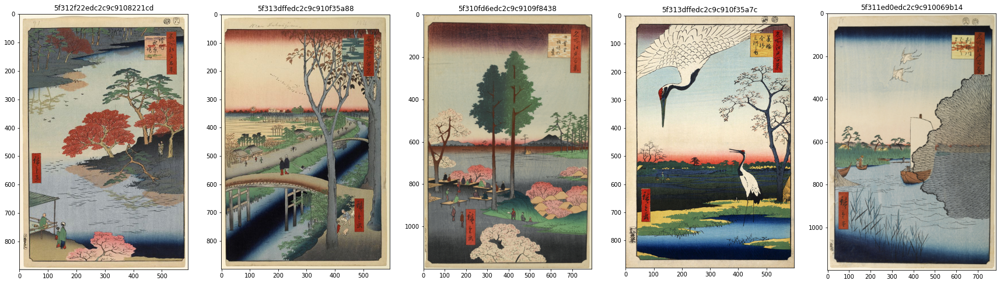

In [ ]:
collect_and_visualize_paintings(df_results6)

In [ ]:
df_results7 =  get_sample_images(list_tags = ["boats-and-ships", "atmospheric-phenomenon"], sample_size=3, debug_flag = True)

df_results7

The query pipeline:
[{'$match': {'metadata.tags': {'$all': ['boats-and-ships',
                                        'atmospheric-phenomenon']}}},
 {'$sample': {'size': 3}}]


,_id,id,title,year,width,height,artistName,image,map,paintingUrl,artistUrl,albums,flags,images,metadata
0,5fefa42250c518576f2e76fb,57726e48edc2cb3880b69b7a,The banks of the Oise,1859,758,364,Charles-Francois Daubigny,https://uploads4.wikiart.org/images/charles-fr...,0123**67*,/en/charles-francois-daubigny/the-banks-of-the...,/en/charles-francois-daubigny,None,2,None,"{'artmovment': ['realism'], 'subject': ['lands..."
1,5fefa74a50c518576f2e7939,57727ac2edc2cb3880dfa4ef,"Merced River, Yosemite Valley",1866,500,360,Albert Bierstadt,https://uploads2.wikiart.org/images/albert-bie...,0*23**67*,/en/albert-bierstadt/merced-river-yosemite-val...,/en/albert-bierstadt,None,2,None,"{'artmovment': ['luminism'], 'subject': ['land..."
2,5fefa06450c518576f2e73fa,57726fcbedc2cb3880bbc555,The monastery of George. Cape Fiolent,1846,1000,635,Ivan Aivazovsky,https://uploads0.wikiart.org/images/ivan-aivaz...,0123**67*,/en/ivan-aivazovsky/the-monastery-of-george-ca...,/en/ivan-aivazovsky,None,2,None,"{'artmovment': ['romanticism'], 'subject': ['l..."


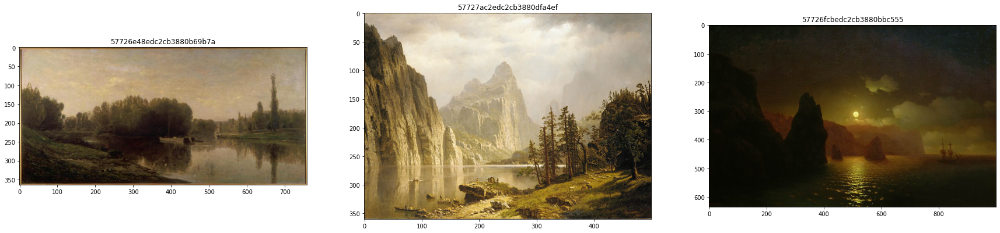

In [ ]:
collect_and_visualize_paintings(df_results7)

In [ ]:
df_results8 =  get_sample_images( artmovement = "neoclassicism", technique="oil",
                                  list_tags = [], sample_size=3, debug_flag = True)

df_results8

The query pipeline:
[{'$match': {'$and': [{'metadata.artmovment': {'$in': ['neoclassicism']}},
                      {'metadata.technique': {'$in': ['oil']}}]}},
 {'$sample': {'size': 3}}]


,_id,id,title,year,width,height,artistName,image,map,paintingUrl,artistUrl,albums,flags,images,metadata
0,5fefa06450c518576f2e741e,5dc3b8c4edc2c95e3c6939e1,L'acqueduc De Carpentras,XVIII-XIX cent.,3765,2747,Jean-Joseph-Xavier Bidauld,https://uploads3.wikiart.org/00261/images/jean...,01234567*,/en/jean-joseph-xavier-bidauld/lacqueduc-de-ca...,/en/jean-joseph-xavier-bidauld,None,2,None,"{'artmovment': ['neoclassicism'], 'subject': [..."
1,5fef7cc950c518576f2e6fa0,5d35b780edc2cbafe47dfc81,Alexander at the Tomb of Cyrus the Great,1796,3000,1336,Pierre-Henri de Valenciennes,https://uploads3.wikiart.org/00246/images/pier...,01234567*,/en/pierre-henri-de-valenciennes/alexander-at-...,/en/pierre-henri-de-valenciennes,None,2,None,"{'artmovment': ['neoclassicism'], 'subject': [..."
2,5fefa0b450c518576f2e7437,5dc3b8e3edc2c95e3c69fe20,Rocky Coastline with Castle,XVIII-XIX cent.,3000,2014,Jean-Joseph-Xavier Bidauld,https://uploads8.wikiart.org/00261/images/jean...,01234567*,/en/jean-joseph-xavier-bidauld/rocky-coastline...,/en/jean-joseph-xavier-bidauld,None,2,None,"{'artmovment': ['neoclassicism'], 'subject': [..."


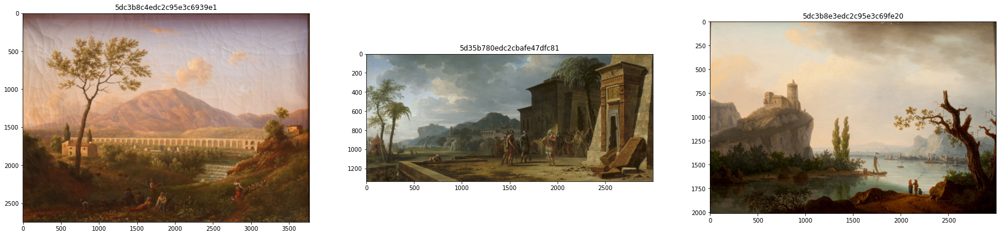

In [ ]:
collect_and_visualize_paintings(df_results8)

In [ ]:
df_results9 =  get_sample_images( technique="etching",
                                  list_tags = [], sample_size=3, debug_flag = True)

df_results9

The query pipeline:
[{'$match': {'metadata.technique': {'$in': ['etching']}}},
 {'$sample': {'size': 3}}]


,_id,id,title,year,width,height,artistName,image,map,paintingUrl,artistUrl,albums,flags,images,metadata
0,5fef78b750c518576f2e6c92,57727ca6edc2cb3880e54382,Path along a lighthouse on the beach,1614,889,500,Esaias van de Velde,https://uploads8.wikiart.org/images/esaias-van...,0123**67*,/en/esaias-van-de-velde/path-along-a-lighthous...,/en/esaias-van-de-velde,None,2,None,"{'artmovment': ['baroque'], 'subject': ['lands..."
1,5fef786750c518576f2e6c3f,5f717510edc2c9bc482c5dad,"Farms, Cattle with Herdsmen and Milkmaids in t...",1559-1561,3398,2375,Master of the Small Landscapes,https://uploads2.wikiart.org/00308/images/mast...,01234567*,/en/master-of-the-small-landscapes/farms-cattl...,/en/master-of-the-small-landscapes,None,2,None,"{'artmovment': ['northern-renaissance'], 'subj..."
2,5fef78b750c518576f2e6c74,5f716bccedc2c9bc48fd94d8,"Village Road, plate 3 from Regiunculae et Vill...",1610,3961,2628,Master of the Small Landscapes,https://uploads6.wikiart.org/00308/images/mast...,01234567*,/en/master-of-the-small-landscapes/village-roa...,/en/master-of-the-small-landscapes,None,2,None,"{'artmovment': ['northern-renaissance'], 'subj..."


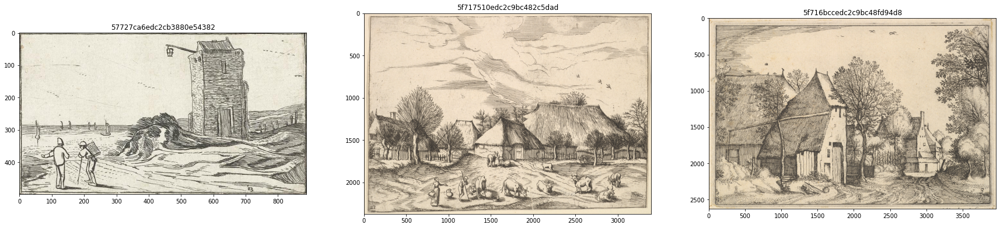

In [ ]:
collect_and_visualize_paintings(df_results9)

--------------------------

## Tensorflow model

### Download pretrained DeepLab v3 model for Semantic Image Segmentation

We download the pretrained DeepLab v3 model on ADE20K, from the TF models zoo [1]

[1] https://github.com/tensorflow/models/blob/master/research/deeplab/g3doc/model_zoo.md

In [ ]:
!wget --spider http://download.tensorflow.org/models/deeplabv3_xception_ade20k_train_2018_05_29.tar.gz

Spider mode enabled. Check if remote file exists.
--2021-01-03 20:42:21--  http://download.tensorflow.org/models/deeplabv3_xception_ade20k_train_2018_05_29.tar.gz
Resolving download.tensorflow.org (download.tensorflow.org)... 172.217.5.240, 2607:f8b0:4004:804::2010
Connecting to download.tensorflow.org (download.tensorflow.org)|172.217.5.240|:80... connected.
HTTP request sent, awaiting response... 200 OK
Length: 460299576 (439M) [application/x-tar]
Remote file exists.



In [ ]:
!mkdir -p /tmp/tfzoo_models/
!wget --quiet --directory-prefix=/tmp/tfzoo_models/  http://download.tensorflow.org/models/deeplabv3_xception_ade20k_train_2018_05_29.tar.gz

In [ ]:
%%bash

cd /tmp/tfzoo_models/
tar -xzf deeplabv3_xception_ade20k_train_2018_05_29.tar.gz

tree --du -h deeplabv3_xception_ade20k_train

deeplabv3_xception_ade20k_train
├── [158M]  frozen_inference_graph.pb
├── [314M]  model.ckpt.data-00000-of-00001
└── [ 52K]  model.ckpt.index

 472M used in 0 directories, 3 files


### Download ADE20K labels semantics

In [ ]:
!wget --spider https://raw.githubusercontent.com/CSAILVision/sceneparsing/master/objectInfo150.csv

Spider mode enabled. Check if remote file exists.
--2021-01-03 20:42:33--  https://raw.githubusercontent.com/CSAILVision/sceneparsing/master/objectInfo150.csv
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 151.101.0.133, 151.101.64.133, 151.101.128.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|151.101.0.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 5803 (5.7K) [text/plain]
Remote file exists.



In [ ]:
!wget --quiet --directory-prefix=/tmp/tfzoo_models/  https://raw.githubusercontent.com/CSAILVision/sceneparsing/master/objectInfo150.csv
!tree /tmp/tfzoo_models/

/tmp/tfzoo_models/
├── deeplabv3_xception_ade20k_train
│   ├── frozen_inference_graph.pb
│   ├── model.ckpt.data-00000-of-00001
│   └── model.ckpt.index
├── deeplabv3_xception_ade20k_train_2018_05_29.tar.gz
└── objectInfo150.csv

1 directory, 5 files


In [ ]:
!head -n 10  /tmp/tfzoo_models/objectInfo150.csv

Idx,Ratio,Train,Val,Stuff,Name
1,0.1576,11664,1172,1,wall
2,0.1072,6046,612,1,building;edifice
3,0.0878,8265,796,1,sky
4,0.0621,9336,917,1,floor;flooring
5,0.0480,6678,641,0,tree
6,0.0450,6604,643,1,ceiling
7,0.0398,4023,408,1,road;route
8,0.0231,1906,199,0,bed
9,0.0198,4688,460,0,windowpane;window


In [ ]:
df_labels_ade20k = pd.read_csv("/tmp/tfzoo_models/objectInfo150.csv", header = 0)
df_labels_ade20k.head()

,Idx,Ratio,Train,Val,Stuff,Name
0,1,0.1576,11664,1172,1,wall
1,2,0.1072,6046,612,1,building;edifice
2,3,0.0878,8265,796,1,sky
3,4,0.0621,9336,917,1,floor;flooring
4,5,0.0480,6678,641,0,tree


In [ ]:
print("Total: {} rows".format(df_labels_ade20k.shape[0]))

df_labels_ade20k["shortname"] = df_labels_ade20k["Name"].apply(lambda x: x.split(";")[0])
df_labels_ade20k.head()

Total: 150 rows


,Idx,Ratio,Train,Val,Stuff,Name,shortname
0,1,0.1576,11664,1172,1,wall,wall
1,2,0.1072,6046,612,1,building;edifice,building
2,3,0.0878,8265,796,1,sky,sky
3,4,0.0621,9336,917,1,floor;flooring,floor
4,5,0.0480,6678,641,0,tree,tree


In [ ]:
utility_print_lists_columnized(long_list=sorted(list(df_labels_ade20k["shortname"].unique())), num_cols_columnize= 8)

airplane  animal     apparel     arcade        armchair    ashcan      awning       bag
ball      bannister  bar         barrel        base        basket      bathtub      bed
bench     bicycle    blanket     blind         boat        book        bookcase     booth
bottle    box        bridge      buffet        building    bulletin    bus          cabinet
canopy    car        case        ceiling       chair       chandelier  chest        clock
coffee    column     computer    conveyer      counter     countertop  cradle       crt
curtain   cushion    desk        dirt          dishwasher  door        earth        escalator
fan       fence      field       fireplace     flag        floor       flower       food
fountain  glass      grandstand  grass         hill        hood        house        hovel
kitchen   lake       lamp        land          light       microwave   minibike     mirror
monitor   mountain   ottoman     oven          painting    palm        path         person
pier     

In [ ]:
#create a dict to decode numeric label to textual label
dict_decode = dict(zip(df_labels_ade20k["Idx"],df_labels_ade20k["shortname"]))
print("the textual label for 1 is: ",  dict_decode[1])


dict_decode_reversed = {v:k for k,v in dict_decode.items()}
print("the numeric label for boat is: ", dict_decode_reversed["boat"])

the textual label for 1 is:  wall
the numeric label for boat is:  77


### Build TF model with pre- and post- processing layers

In [ ]:
#load the pretrained DeepLab model frozen graph (.pb file) 

@tf.function
def pretrained_model(x):
    tf.print("Begin pretrained_model on:", type(x), tf.shape(x), output_stream=sys.stdout)
    frozen_graph_path = '/tmp/tfzoo_models/deeplabv3_xception_ade20k_train/frozen_inference_graph.pb'
    with tf.io.gfile.GFile(frozen_graph_path, 'rb') as f:
        graph_def = tf.compat.v1.GraphDef()
        graph_def.ParseFromString(f.read())
        the_output1 = tf.graph_util.import_graph_def(graph_def, name='', 
                                                     input_map={'ImageTensor:0': x},
                                                     return_elements=['SemanticPredictions:0', 'ResizeBilinear_3:0'])
        return the_output1


#------------------------------------------------------------

@tf.function
def constants_generator(x):
    #note: the input won't be used in any way, but is needed to keep the model connected
    s1 = tf.constant("input", dtype=tf.string)
    s2 = tf.constant("output_segmap", dtype=tf.string)
    s3 = tf.constant("output_logits", dtype=tf.string)
    #note we can't use concat on scalars (Can't concatenate scalars)
    constants_ = tf.stack([s1, s2, s3])
    return constants_


@tf.function
def memorize_input_size(x):
    x_shp = x.get_shape().as_list()
    #note: since the shape is known only at runtime, it is initially [None None]
    #to create a numpy array from such a list, we need to explicitly set dtype to float
    x_shp_arr = np.array([x_shp[1], x_shp[2]], dtype=np.float)
    x_shp_tensor = tf.constant(x_shp_arr)
    tf.print("Memorized shape:", type(x_shp_tensor), x_shp_tensor, output_stream=sys.stdout)
    return x_shp_tensor

#------------------------------------------------------------

@tf.function
def resize_to_original_shape(x):
    x_im = x[0]
    x_shp = x[1]
    x_im_dtype = x_im.dtype
    tf.print("resize_original_shape:", type(x_im), tf.shape(x_im), output_stream=sys.stdout)
    tf.print("resize_original_shape:", type(x_shp), x_shp,  output_stream=sys.stdout)
    #note: the image must be extended with a 4th dimension, i.e. [1 513 513] -> [1 513 513 1]
    x_im_ = tf.expand_dims(x_im, axis =-1)
    #note: 'size' must be a 1-D int32 Tensor
    x_shp_ = tf.cast(x_shp, dtype=tf.int32)
    #x_shp_tensor = tf.convert_to_tensor(np.array([513,513]), dtype=tf.int32)
    x_res = tf.image.resize(x_im_, size = x_shp_, 
                    method=tf.image.ResizeMethod.BILINEAR, 
                    preserve_aspect_ratio=False,
                    antialias=False)
    x_res_uint8 = tf.cast(x_res, x_im_dtype)
    #remove the added 4th dimension
    x_ret =  tf.squeeze(x_res_uint8, axis = -1)
    return x_ret

#-----------------------------------------------------------
@tf.function
def logits_to_probab(x):
    x_raw_probab = tf.nn.softmax(x)
    #for each pixel get the max among the probabilities of the 151 classes for it
    x_max_probab = tf.math.reduce_max(x_raw_probab, axis =-1)
    tf.print("After softmax:", type(x_max_probab), tf.shape(x_max_probab), output_stream=sys.stdout)
    return x_max_probab

#-----------------------------------------------------------

@tf.function
def debug_function(x):
    tens = x[0]
    msg = x[1]
    tf.print("debug_function for ", msg, " -->", type(tens), " | shape:", tf.shape(tens), 
             " | min:", tf.math.reduce_min(tens), " | max:", tf.math.reduce_max(tens),
             output_stream=sys.stdout)
    return tens
#-----------------------------------------------------------


def build_segmenter():

    tf.keras.backend.clear_session()

    #allow any size and we'll resize it in the lambda layer
    model_input1 = tf.keras.Input(shape=(None, None, 3), dtype=tf.uint8, name = "InputImg")

    #memorize input shape
    input_hw = tf.keras.layers.Lambda(memorize_input_size, name = "memorize_size")(model_input1)


    #note: using constants in keras model, they need to be generated from inside the model
    # (e.g. from a lambdalayer or as input(tensor=tf.variable(tf.constant(...)))),
    # otherwise keras doesn't have knowledge of variables declared directly as a = tf.variable(...) 
    #note: in the latter case, when we try to diagram we get error "object has no attribute '_keras_history'" 

    model_constants = tf.keras.layers.Lambda(constants_generator, name = "constants")(model_input1)
    
    debug_input = tf.keras.layers.Lambda(lambda x: debug_function(x),
                                         name = "debug1")([model_input1, model_constants[0]])


    #resize to required size , in a lambda layer
    input1_resized = tf.keras.layers.Lambda(lambda x: tf.image.resize(x, size=(513,513), 
                                                                      method=tf.image.ResizeMethod.BILINEAR, 
                                                                      preserve_aspect_ratio=False,
                                                                      antialias=False),
                                            name = "resize1")(debug_input)

    input1_prepared = tf.keras.layers.Lambda(lambda x: tf.cast(x, tf.uint8),
                                             name = "prepare1")(input1_resized)


    #the frozen graph loaded in a lambda layer
    deeplab_output = tf.keras.layers.Lambda(pretrained_model,
                                            name = "frozen_inference")(input1_prepared)

    #create an output for each tensor returned 
    output_segmap = tf.keras.layers.Lambda(lambda x: tf.cast(x[0], tf.uint8),
                                           name = "extract_segmap")(deeplab_output)
    output_logits = tf.keras.layers.Lambda(lambda x: x[1],
                                           name = "extract_logits")(deeplab_output)


    #debug printing
    debug_output_segmap = tf.keras.layers.Lambda(lambda x: debug_function(x),
                                                 name = "debug2")([output_segmap, model_constants[1]])
    debug_output_logits = tf.keras.layers.Lambda(lambda x: debug_function(x),
                                                 name = "debug3")([output_logits, model_constants[2]])


    #post-process logits 
    postprocessed_output_logits = tf.keras.layers.Lambda(lambda x: logits_to_probab(x),
                                                          name = "postproc")(debug_output_logits)

    #resize to original image shape, which was (1,h,w,3)
    output_segmap_resized = tf.keras.layers.Lambda(lambda x: resize_to_original_shape(x),
                                                   name = "resize2")([debug_output_segmap, input_hw])

    output_probab_resized = tf.keras.layers.Lambda(lambda x: resize_to_original_shape(x),
                                                   name = "resize3")([postprocessed_output_logits, input_hw])
    

    model = tf.keras.Model([model_input1] ,  
                           [output_segmap_resized, output_probab_resized], 
                           name = "segmentation_model")

    return model


In [ ]:
model_image_segmentation = build_segmenter()
model_image_segmentation.summary()

Model: "segmentation_model"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
InputImg (InputLayer)           [(None, None, None,  0                                            
__________________________________________________________________________________________________
constants (Lambda)              (3,)                 0           InputImg[0][0]                   
__________________________________________________________________________________________________
tf.__operators__.getitem (Slici ()                   0           constants[0][0]                  
__________________________________________________________________________________________________
debug1 (Lambda)                 (None, None, None, 3 0           InputImg[0][0]                   
                                                                 tf.__operators__

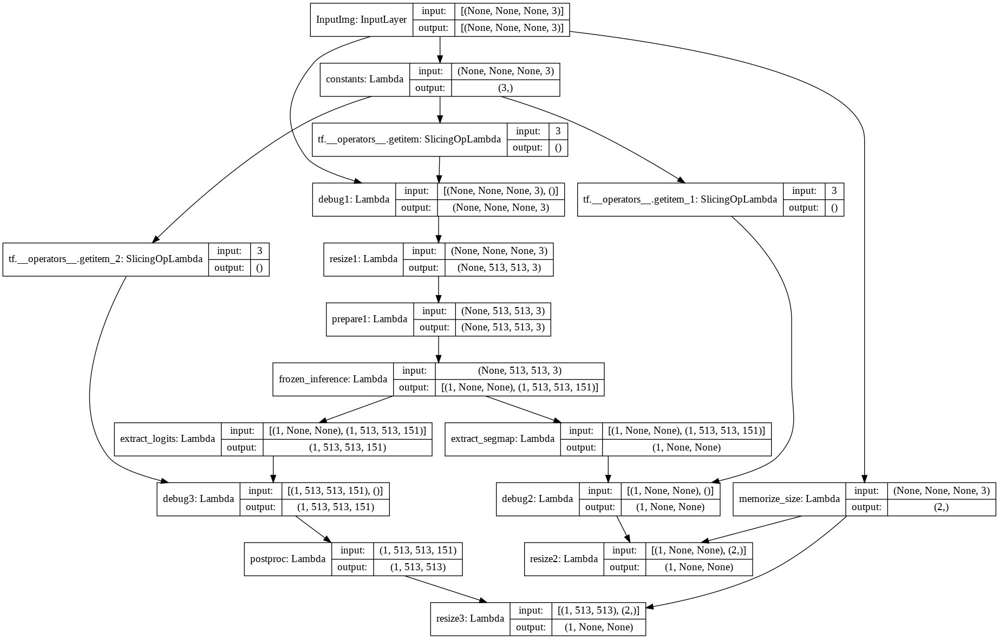

In [ ]:
tf.keras.utils.plot_model(model_image_segmentation, show_shapes = True)

### Inference with the TF model

#### ILLUSTRATION 1 - DETAILED STEP-BY-STEP

In [ ]:
def get_image(file_path):
    """ read image from specified location, which can be the 
        local filesystem path or a GCP Storage blob URI"""
    with file_io.FileIO(file_path, 'rb') as f:
        im = tf.io.decode_image(f.read())
        #since we're in eager execution mode in TF, we can easily convert tensor to numpy
        im_arr = im.numpy()
    return im, im_arr

In [ ]:
file_path = FOLDER_IMAGES + df_results1.iloc[1]["id"] + ".jpg"

im1_tens, im1_arr = get_image(file_path = file_path)
print("im_tens:".ljust(20), im1_tens.shape, im1_tens.dtype, type(im1_tens))
print("im_arr:".ljust(20), im1_arr.shape, im1_arr.dtype, type(im1_arr))

im_tens:             (1656, 2024, 3) <dtype: 'uint8'> <class 'tensorflow.python.framework.ops.EagerTensor'>
im_arr:              (1656, 2024, 3) uint8 <class 'numpy.ndarray'>


In [ ]:
im1_tens_batch = tf.expand_dims(im1_tens, 0)
im1_tens_batch.shape

TensorShape([1, 1656, 2024, 3])

In [ ]:
%%time

res_prediction = model_image_segmentation.predict(im1_tens_batch)

debug_function for  "input"  --> <class 'tensorflow.python.framework.ops.Tensor'>  | shape: [1 1656 2024 3]  | min: 0  | max: 255
Begin pretrained_model on: <class 'tensorflow.python.framework.ops.Tensor'> [1 513 513 3]
debug_function for  "output_logits"  --> <class 'tensorflow.python.framework.ops.Tensor'>  | shape: [1 513 513 151]  | min: -8.52288628  | max: 21.0852642
After softmax: <class 'tensorflow.python.framework.ops.Tensor'> [1 513 513]
Memorized shape: <class 'tensorflow.python.framework.ops.Tensor'> [1656 2024]
debug_function for  "output_segmap"  --> <class 'tensorflow.python.framework.ops.Tensor'>  | shape: [1 513 513]  | min: 1  | max: 70
resize_original_shape: <class 'tensorflow.python.framework.ops.Tensor'> [1 513 513]
resize_original_shape: <class 'tensorflow.python.framework.ops.Tensor'> [1656 2024]
resize_original_shape: <class 'tensorflow.python.framework.ops.Tensor'> [1 513 513]
resize_original_shape: <class 'tensorflow.python.framework.ops.Tensor'> [1656 2024]
CP

Note: the lazy eval of memorize shape, only when its result is needed after the inference

In [ ]:
print("res_prediction is a {} of {} items ".format(type(res_prediction), len(res_prediction)))

for ii in range(len(res_prediction)):
    print(type(res_prediction[ii]), res_prediction[ii].shape, res_prediction[ii].dtype,
          " | min:", res_prediction[ii].min(), " max:", res_prediction[ii].max())

res_prediction is a <class 'list'> of 2 items 
<class 'numpy.ndarray'> (1, 1656, 2024) uint8  | min: 1  max: 70
<class 'numpy.ndarray'> (1, 1656, 2024) float32  | min: 0.16406684  max: 0.99998796


recap: we had 150 rows in df_labels_ade20k

In [ ]:
def decode_and_compute_classes_pixels_ratios(arr_seg_map, decoded_names = True):

    label_counts = coll.Counter(arr_seg_map.flatten())
    #print(label_counts)

    total_pixels = arr_seg_map.shape[-2] * arr_seg_map.shape[-1]
    #print("total pixels=", total_pixels, " sum counter=", sum(label_counts.values()))
    #assert(total_pixels == sum(label_counts.values()))

    dict_percentages = {k: round(100.0 * v/total_pixels, 2) for k,v in label_counts.items()}
    #print(dict_percentages)
    
    if decoded_names is True:
        dict_percentages_ = {dict_decode[k] : v for k,v in dict_percentages.items() if k in dict_decode}
    else:
        dict_percentages_ = {k : v for k,v in dict_percentages.items()}

    #now sort the dict by value
    sorted_dict_percentages = sorted(dict_percentages_.items(), key=lambda v: -v[1])
    sorted_dict_percentages_ = collections.OrderedDict(sorted_dict_percentages)

    #to occupy at least 0.25% of area
    filter_top_percentages_ = {k:v for k,v in sorted_dict_percentages_.items() if v > 0.25 }
    sorted_resp = coll.OrderedDict(sorted(filter_top_percentages_.items(), key=lambda x: x[1], reverse=True))
    return sorted_resp

In [ ]:
decode_and_compute_classes_pixels_ratios(res_prediction[0])

OrderedDict([('tree', 35.05),
             ('sky', 28.43),
             ('earth', 23.43),
             ('water', 4.5),
             ('person', 2.12),
             ('grass', 1.42),
             ('path', 1.35),
             ('building', 0.67),
             ('wall', 0.43),
             ('floor', 0.39),
             ('plant', 0.29)])

In [ ]:
def end2end_prediction(wikiart_id):
    file_path = FOLDER_IMAGES + wikiart_id + ".jpg"

    #because of tf.functions liecycle, we need this:
    model_image_segmentation = build_segmenter()

    im1_tens, im1_arr = get_image(file_path = file_path)

    im1_tens_batch = tf.expand_dims(im1_tens, 0)

    res_prediction = model_image_segmentation.predict(im1_tens_batch)

    return im1_arr, res_prediction

**Create custom colormap based on [4] and [5]**

[4] https://github.com/tensorflow/models/blob/master/research/deeplab/utils/get_dataset_colormap.py   
[5] https://stackoverflow.com/questions/11364745/how-can-i-turn-a-numpy-array-into-a-matplotlib-colormap

In [ ]:
#create custom colormap,
#changed color of human(13) from [150, 5, 61]  -> [164, 10, 247]
#changed color of field(30) from  [112, 9, 255] -> [252, 247, 78]
#changed color of bottle(99) from [0, 255, 10] -> [240, 151, 185]
#changed color of boat(77) from [173, 255, 0] -> [255, 114, 59]

colorise = np.asarray([
      [0, 0, 0], [120, 120, 120], [180, 120, 120], [6, 230, 230], [80, 50, 50],
      [4, 200, 3], [120, 120, 80], [140, 140, 140], [204, 5, 255], [230, 230, 230],
      [4, 250, 7], [224, 5, 255],  [235, 255, 7], [164, 10, 247], [120, 120, 70],
      [8, 255, 51], [255, 6, 82], [143, 255, 140], [204, 255, 4], [255, 51, 7],
      [204, 70, 3], [0, 102, 200], [61, 230, 250], [255, 6, 51], [11, 102, 255],
      [255, 7, 71], [255, 9, 224], [9, 7, 230],[220, 220, 220], [255, 9, 92],
      [252, 247, 78], [8, 255, 214], [7, 255, 224], [255, 184, 6], [10, 255, 71],
      [255, 41, 10], [7, 255, 255], [224, 255, 8], [102, 8, 255], [255, 61, 6],
      [255, 194, 7], [255, 122, 8], [0, 255, 20], [255, 8, 41], [255, 5, 153],
      [6, 51, 255], [235, 12, 255], [160, 150, 20], [0, 163, 255], [140, 140, 140],
      [250, 10, 15], [20, 255, 0], [31, 255, 0], [255, 31, 0], [255, 224, 0],
      [153, 255, 0], [0, 0, 255], [255, 71, 0], [0, 235, 255],  [0, 173, 255],
      [31, 0, 255], [11, 200, 200], [255, 82, 0], [0, 255, 245], [0, 61, 255],
      [0, 255, 112], [0, 255, 133], [255, 0, 0], [255, 163, 0], [255, 102, 0],
      [194, 255, 0], [0, 143, 255], [51, 255, 0], [0, 82, 255], [0, 255, 41],
      [0, 255, 173], [10, 0, 255], [255, 114, 59], [0, 255, 153], [255, 92, 0],
      [255, 0, 255], [255, 0, 245], [255, 0, 102], [255, 173, 0], [255, 0, 20],
      [255, 184, 184], [0, 31, 255], [0, 255, 61], [0, 71, 255], [255, 0, 204],
      [0, 255, 194], [0, 255, 82], [0, 10, 255], [0, 112, 255], [51, 0, 255],
      [0, 194, 255], [0, 122, 255], [0, 255, 163], [255, 153, 0], [240, 151, 185],
      [255, 112, 0], [143, 255, 0], [82, 0, 255], [163, 255, 0], [255, 235, 0],
      [8, 184, 170], [133, 0, 255], [0, 255, 92], [184, 0, 255], [255, 0, 31],
      [0, 184, 255], [0, 214, 255], [255, 0, 112], [92, 255, 0],  [0, 224, 255],
      [112, 224, 255], [70, 184, 160], [163, 0, 255], [153, 0, 255], [71, 255, 0],
      [255, 0, 163], [255, 204, 0], [255, 0, 143], [0, 255, 235], [133, 255, 0],
      [255, 0, 235], [245, 0, 255], [255, 0, 122], [255, 245, 0], [10, 190, 212],
      [214, 255, 0], [0, 204, 255], [20, 0, 255], [255, 255, 0], [0, 153, 255],
      [0, 41, 255], [0, 255, 204], [41, 0, 255], [41, 255, 0], [173, 0, 255],
      [0, 245, 255], [71, 0, 255], [122, 0, 255], [0, 255, 184], [0, 92, 255],
      [184, 255, 0], [0, 133, 255], [255, 214, 0], [25, 194, 194], [102, 255, 0],
      [92, 0, 255],
  ])

colorise_ = np.c_[colorise/255., np.ones(len(colorise))]
colorise_cmap = colors.LinearSegmentedColormap.from_list('my_colormap', colorise_, N=151)

In [ ]:
def visualize_prediction_and_confidence(im1_arr, res_prediction):
    #plot original and segmentation map
    fig,ax = plt.subplots(1,3, figsize=(30,12))
    ax[0].imshow(np.array(im1_arr))
    ax[0].set_title("Original")

    ax[1].imshow(np.array(im1_arr))
    ax[1].imshow(res_prediction[0][0], cmap=colorise_cmap, vmin=0, vmax = 150, alpha = 0.6)
    ax[1].set_title("Prediction result")

    ax[2].imshow(res_prediction[1][0], cmap="seismic", vmin=0, vmax = 1, alpha = 1.0)
    ax[2].set_title("Confidence heatmap")
    fig.tight_layout();

    #also make a figure with color legend for top frequent classes present in the image
    dict_freq_classes = decode_and_compute_classes_pixels_ratios(res_prediction[0])
    #note: the dict may have variable number of entries (all with value > 0.1)
    fig2, ax = plt.subplots(1,1, figsize = (30,1))
    ii = 0
    h_rect = 10
    w_rect = 30
    for k,v in dict_freq_classes.items():
        class_id = df_labels_ade20k.loc[df_labels_ade20k["shortname"] == k, "Idx"].values[0]
        start_x = ii * ( w_rect + 15 )
        rect1 = Rectangle((start_x, 0), w_rect, h_rect, color=colorise_[class_id])
        ax.add_patch(rect1)
        s = "{}/{} ".format(k, class_id)
        ax.text(start_x, h_rect + 5, s, fontsize=12)
        ii += 1

    ax.set_xlim(-30, (ii +2) * ( w_rect + 15 ))
    ax.set_ylim(0, 30)
    ax.axis("off")

In [ ]:
%%time
im1_arr, res_prediction = end2end_prediction(wikiart_id = df_results1.iloc[1]["id"])

debug_function for  "input"  --> <class 'tensorflow.python.framework.ops.Tensor'>  | shape: [1 1656 2024 3]  | min: 0  | max: 255
Begin pretrained_model on: <class 'tensorflow.python.framework.ops.Tensor'> [1 513 513 3]
debug_function for  "output_logits"  --> <class 'tensorflow.python.framework.ops.Tensor'>  | shape: [1 513 513 151]  | min: -8.52288628  | max: 21.0852642
After softmax: <class 'tensorflow.python.framework.ops.Tensor'> [1 513 513]
Memorized shape: <class 'tensorflow.python.framework.ops.Tensor'> [1656 2024]
debug_function for  "output_segmap"  --> <class 'tensorflow.python.framework.ops.Tensor'>  | shape: [1 513 513]  | min: 1  | max: 70
resize_original_shape: <class 'tensorflow.python.framework.ops.Tensor'> [1 513 513]
resize_original_shape: <class 'tensorflow.python.framework.ops.Tensor'> [1656 2024]
resize_original_shape: <class 'tensorflow.python.framework.ops.Tensor'> [1 513 513]
resize_original_shape: <class 'tensorflow.python.framework.ops.Tensor'> [1656 2024]
CP

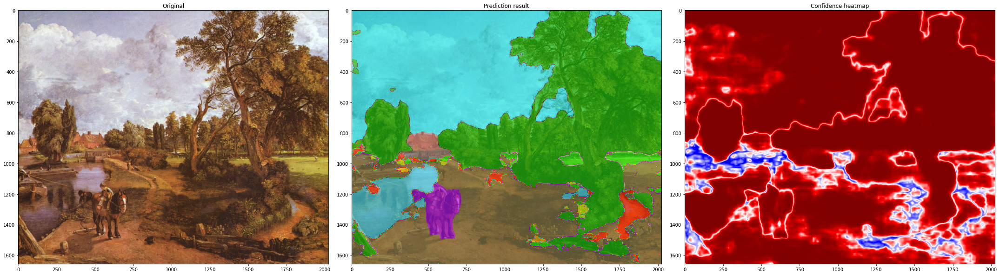

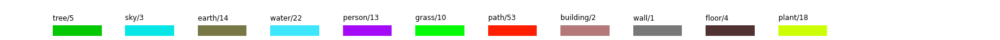

In [ ]:
visualize_prediction_and_confidence(im1_arr, res_prediction)

Note: in the above painting: man on a horse = man

#### ILLUSTRATION 2

In [ ]:
im1_arr, res_prediction = end2end_prediction(wikiart_id = df_results1.iloc[0]["id"])

debug_function for  "input"  --> <class 'tensorflow.python.framework.ops.Tensor'>  | shape: [1 592 800 3]  | min: 0  | max: 255
Begin pretrained_model on: <class 'tensorflow.python.framework.ops.Tensor'> [1 513 513 3]
debug_function for  "output_logits"  --> <class 'tensorflow.python.framework.ops.Tensor'>  | shape: [1 513 513 151]  | min: -12.5736008  | max: 22.3850384
After softmax: <class 'tensorflow.python.framework.ops.Tensor'> [1 513 513]
Memorized shape: <class 'tensorflow.python.framework.ops.Tensor'> [592 800]
debug_function for  "output_segmap"  --> <class 'tensorflow.python.framework.ops.Tensor'>  | shape: [1 513 513]  | min: 3  | max: 127
resize_original_shape: <class 'tensorflow.python.framework.ops.Tensor'> [1 513 513]
resize_original_shape: <class 'tensorflow.python.framework.ops.Tensor'> [592 800]
resize_original_shape: <class 'tensorflow.python.framework.ops.Tensor'> [1 513 513]
resize_original_shape: <class 'tensorflow.python.framework.ops.Tensor'> [592 800]


In [ ]:
decode_and_compute_classes_pixels_ratios(res_prediction[0])

OrderedDict([('tree', 36.73),
             ('sky', 28.15),
             ('water', 21.38),
             ('earth', 3.89),
             ('rock', 3.06),
             ('plant', 1.61),
             ('house', 1.28),
             ('person', 0.89),
             ('floor', 0.77),
             ('grass', 0.45)])

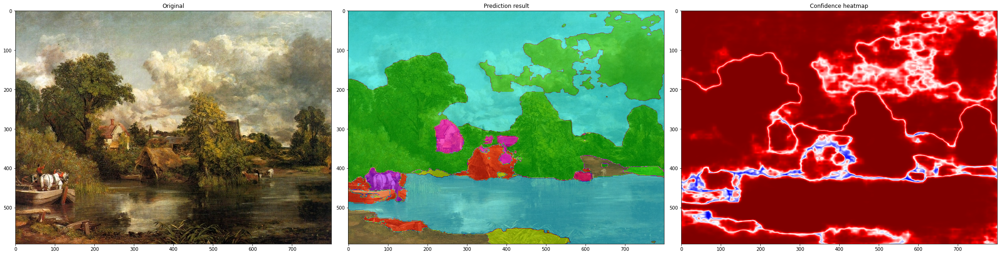

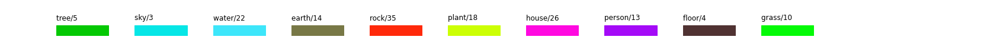

In [ ]:
visualize_prediction_and_confidence(im1_arr, res_prediction)

#### ILLUSTRATION 3

In [ ]:
im1_arr, res_prediction = end2end_prediction(wikiart_id = df_results2.iloc[0]["id"])

debug_function for  "input"  --> <class 'tensorflow.python.framework.ops.Tensor'>  | shape: [1 4360 5920 3]  | min: 0  | max: 255
Begin pretrained_model on: <class 'tensorflow.python.framework.ops.Tensor'> [1 513 513 3]
debug_function for  "output_logits"  --> <class 'tensorflow.python.framework.ops.Tensor'>  | shape: [1 513 513 151]  | min: -10.1472101  | max: 20.2150364
After softmax: <class 'tensorflow.python.framework.ops.Tensor'> [1 513 513]
Memorized shape: <class 'tensorflow.python.framework.ops.Tensor'> [4360 5920]
debug_function for  "output_segmap"  --> <class 'tensorflow.python.framework.ops.Tensor'>  | shape: [1 513 513]  | min: 1  | max: 127
resize_original_shape: <class 'tensorflow.python.framework.ops.Tensor'> [1 513 513]
resize_original_shape: <class 'tensorflow.python.framework.ops.Tensor'> [4360 5920]
resize_original_shape: <class 'tensorflow.python.framework.ops.Tensor'> [1 513 513]
resize_original_shape: <class 'tensorflow.python.framework.ops.Tensor'> [4360 5920]


In [ ]:
decode_and_compute_classes_pixels_ratios(res_prediction[0])

OrderedDict([('tree', 28.41),
             ('earth', 27.1),
             ('sky', 17.05),
             ('person', 7.44),
             ('field', 4.44),
             ('wall', 4.31),
             ('land', 1.95),
             ('hill', 1.59),
             ('building', 1.41),
             ('sand', 1.15),
             ('mountain', 1.03),
             ('floor', 0.84),
             ('plant', 0.26)])

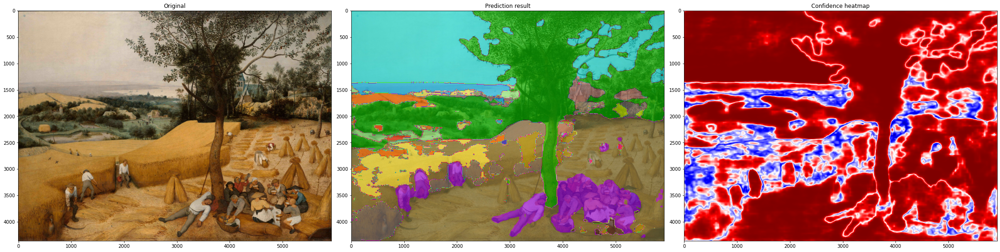

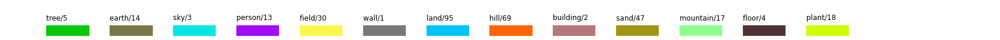

In [ ]:
visualize_prediction_and_confidence(im1_arr, res_prediction)

#### ILLUSTRATION 4

In [ ]:
im1_arr, res_prediction = end2end_prediction(wikiart_id = df_results3.iloc[2]["id"])

debug_function for  "input"  --> <class 'tensorflow.python.framework.ops.Tensor'>  | shape: [1 495 741 3]  | min: 0  | max: 255
Begin pretrained_model on: <class 'tensorflow.python.framework.ops.Tensor'> [1 513 513 3]
debug_function for  "output_logits"  --> <class 'tensorflow.python.framework.ops.Tensor'>  | shape: [1 513 513 151]  | min: -13.5734196  | max: 22.7165127
After softmax: <class 'tensorflow.python.framework.ops.Tensor'> [1 513 513]
Memorized shape: <class 'tensorflow.python.framework.ops.Tensor'> [495 741]
debug_function for  "output_segmap"  --> <class 'tensorflow.python.framework.ops.Tensor'>  | shape: [1 513 513]  | min: 1  | max: 99
resize_original_shape: <class 'tensorflow.python.framework.ops.Tensor'> [1 513 513]
resize_original_shape: <class 'tensorflow.python.framework.ops.Tensor'> [495 741]
resize_original_shape: <class 'tensorflow.python.framework.ops.Tensor'> [1 513 513]
resize_original_shape: <class 'tensorflow.python.framework.ops.Tensor'> [495 741]


In [ ]:
decode_and_compute_classes_pixels_ratios(res_prediction[0])

OrderedDict([('sky', 36.09),
             ('tree', 22.08),
             ('floor', 13.18),
             ('column', 9.72),
             ('railing', 6.82),
             ('fence', 4.22),
             ('grass', 3.68),
             ('water', 0.82),
             ('bottle', 0.81),
             ('earth', 0.55)])

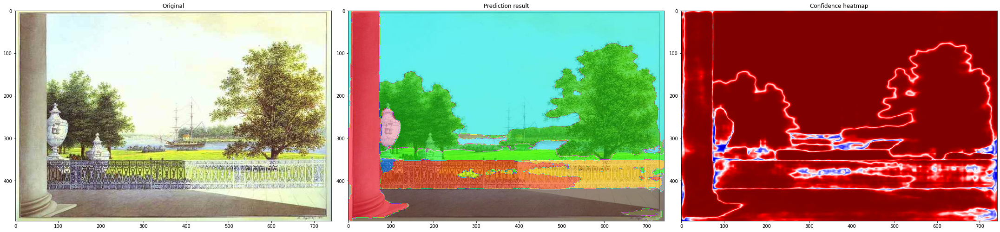

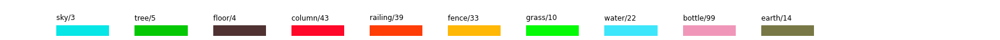

In [ ]:
visualize_prediction_and_confidence(im1_arr, res_prediction)

#### ILLUSTRATION 5

In [ ]:
im1_arr, res_prediction = end2end_prediction(wikiart_id = df_results4.iloc[2]["id"])

debug_function for  "input"  --> <class 'tensorflow.python.framework.ops.Tensor'>  | shape: [1 1248 2280 3]  | min: 0  | max: 255
Begin pretrained_model on: <class 'tensorflow.python.framework.ops.Tensor'> [1 513 513 3]
debug_function for  "output_logits"  --> <class 'tensorflow.python.framework.ops.Tensor'>  | shape: [1 513 513 151]  | min: -9.63740349  | max: 21.9657917
After softmax: <class 'tensorflow.python.framework.ops.Tensor'> [1 513 513]
Memorized shape: <class 'tensorflow.python.framework.ops.Tensor'> [1248 2280]
debug_function for  "output_segmap"  --> <class 'tensorflow.python.framework.ops.Tensor'>  | shape: [1 513 513]  | min: 1  | max: 104
resize_original_shape: <class 'tensorflow.python.framework.ops.Tensor'> [1 513 513]
resize_original_shape: <class 'tensorflow.python.framework.ops.Tensor'> [1248 2280]
resize_original_shape: <class 'tensorflow.python.framework.ops.Tensor'> [1 513 513]
resize_original_shape: <class 'tensorflow.python.framework.ops.Tensor'> [1248 2280]


In [ ]:
decode_and_compute_classes_pixels_ratios(res_prediction[0])

OrderedDict([('sky', 47.8),
             ('mountain', 26.68),
             ('sea', 16.98),
             ('rock', 1.66),
             ('earth', 1.63),
             ('railing', 1.44),
             ('sand', 1.13),
             ('person', 0.34)])

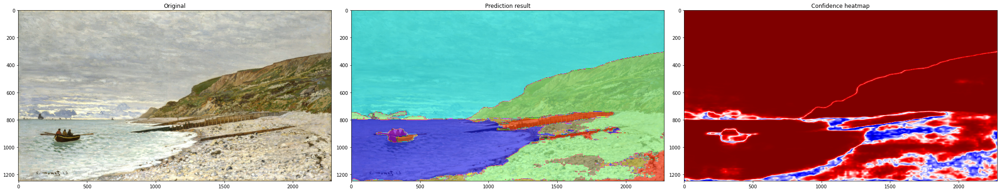

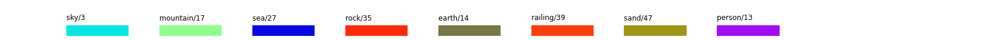

In [ ]:
visualize_prediction_and_confidence(im1_arr, res_prediction)

#### ILLUSTRATION 6

In [ ]:
im1_arr, res_prediction = end2end_prediction(wikiart_id = df_results7.iloc[1]["id"])

debug_function for  "input"  --> <class 'tensorflow.python.framework.ops.Tensor'>  | shape: [1 360 500 3]  | min: 0  | max: 255
Begin pretrained_model on: <class 'tensorflow.python.framework.ops.Tensor'> [1 513 513 3]
debug_function for  "output_logits"  --> <class 'tensorflow.python.framework.ops.Tensor'>  | shape: [1 513 513 151]  | min: -10.3297386  | max: 21.8573437
After softmax: <class 'tensorflow.python.framework.ops.Tensor'> [1 513 513]
Memorized shape: <class 'tensorflow.python.framework.ops.Tensor'> [360 500]
debug_function for  "output_segmap"  --> <class 'tensorflow.python.framework.ops.Tensor'>  | shape: [1 513 513]  | min: 3  | max: 35
resize_original_shape: <class 'tensorflow.python.framework.ops.Tensor'> [1 513 513]
resize_original_shape: <class 'tensorflow.python.framework.ops.Tensor'> [360 500]
resize_original_shape: <class 'tensorflow.python.framework.ops.Tensor'> [1 513 513]
resize_original_shape: <class 'tensorflow.python.framework.ops.Tensor'> [360 500]


In [ ]:
decode_and_compute_classes_pixels_ratios(res_prediction[0])

OrderedDict([('sky', 35.68),
             ('mountain', 27.32),
             ('earth', 14.54),
             ('tree', 10.99),
             ('water', 9.93),
             ('rock', 0.37)])

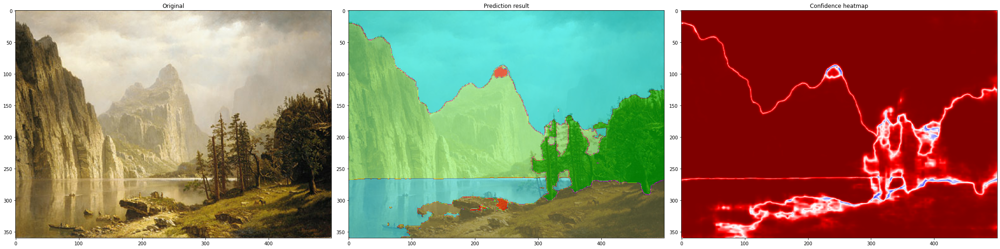

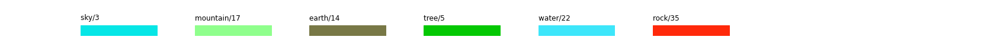

In [ ]:
visualize_prediction_and_confidence(im1_arr, res_prediction)

#### ILLUSTRATION 7

In [ ]:
im1_arr, res_prediction = end2end_prediction(wikiart_id = df_results8.iloc[2]["id"])

debug_function for  "input"  --> <class 'tensorflow.python.framework.ops.Tensor'>  | shape: [1 2014 3000 3]  | min: 0  | max: 255
Begin pretrained_model on: <class 'tensorflow.python.framework.ops.Tensor'> [1 513 513 3]
debug_function for  "output_logits"  --> <class 'tensorflow.python.framework.ops.Tensor'>  | shape: [1 513 513 151]  | min: -8.83226585  | max: 21.9948483
After softmax: <class 'tensorflow.python.framework.ops.Tensor'> [1 513 513]
Memorized shape: <class 'tensorflow.python.framework.ops.Tensor'> [2014 3000]
debug_function for  "output_segmap"  --> <class 'tensorflow.python.framework.ops.Tensor'>  | shape: [1 513 513]  | min: 2  | max: 35
resize_original_shape: <class 'tensorflow.python.framework.ops.Tensor'> [1 513 513]
resize_original_shape: <class 'tensorflow.python.framework.ops.Tensor'> [2014 3000]
resize_original_shape: <class 'tensorflow.python.framework.ops.Tensor'> [1 513 513]
resize_original_shape: <class 'tensorflow.python.framework.ops.Tensor'> [2014 3000]


In [ ]:
decode_and_compute_classes_pixels_ratios(res_prediction[0])

OrderedDict([('sky', 52.4),
             ('tree', 12.09),
             ('water', 11.35),
             ('building', 7.82),
             ('earth', 5.85),
             ('rock', 5.46),
             ('mountain', 1.82),
             ('plant', 0.95),
             ('person', 0.34),
             ('floor', 0.33)])

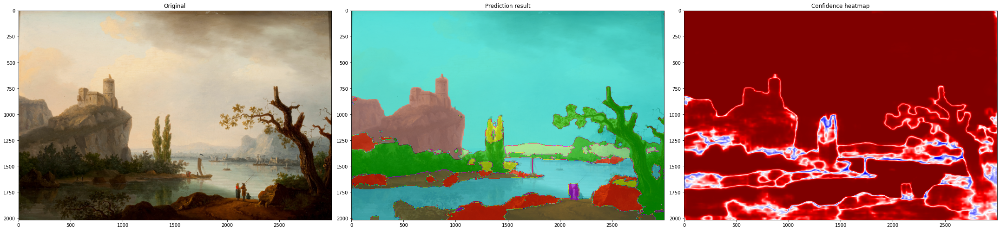

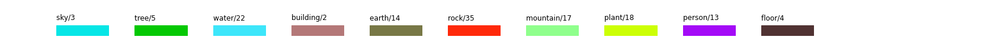

In [ ]:
visualize_prediction_and_confidence(im1_arr, res_prediction)

#### ILLUSTRATION 8

In this example we make inference on a painting of circle shape

In [ ]:
im1_arr, res_prediction = end2end_prediction(wikiart_id = df_results5.iloc[0]["id"])

debug_function for  "input"  --> <class 'tensorflow.python.framework.ops.Tensor'>  | shape: [1 794 800 3]  | min: 0  | max: 255
Begin pretrained_model on: <class 'tensorflow.python.framework.ops.Tensor'> [1 513 513 3]
debug_function for  "output_logits"  --> <class 'tensorflow.python.framework.ops.Tensor'>  | shape: [1 513 513 151]  | min: -12.0060139  | max: 19.7736378
After softmax: <class 'tensorflow.python.framework.ops.Tensor'> [1 513 513]
Memorized shape: <class 'tensorflow.python.framework.ops.Tensor'> [794 800]
debug_function for  "output_segmap"  --> <class 'tensorflow.python.framework.ops.Tensor'>  | shape: [1 513 513]  | min: 1  | max: 149
resize_original_shape: <class 'tensorflow.python.framework.ops.Tensor'> [1 513 513]
resize_original_shape: <class 'tensorflow.python.framework.ops.Tensor'> [794 800]
resize_original_shape: <class 'tensorflow.python.framework.ops.Tensor'> [1 513 513]
resize_original_shape: <class 'tensorflow.python.framework.ops.Tensor'> [794 800]


In [ ]:
decode_and_compute_classes_pixels_ratios(res_prediction[0])

OrderedDict([('sky', 38.37),
             ('building', 22.93),
             ('tree', 10.97),
             ('earth', 10.93),
             ('tent', 5.22),
             ('rock', 3.45),
             ('person', 2.5),
             ('animal', 0.93),
             ('floor', 0.61),
             ('sculpture', 0.51),
             ('ceiling', 0.45),
             ('plant', 0.37)])

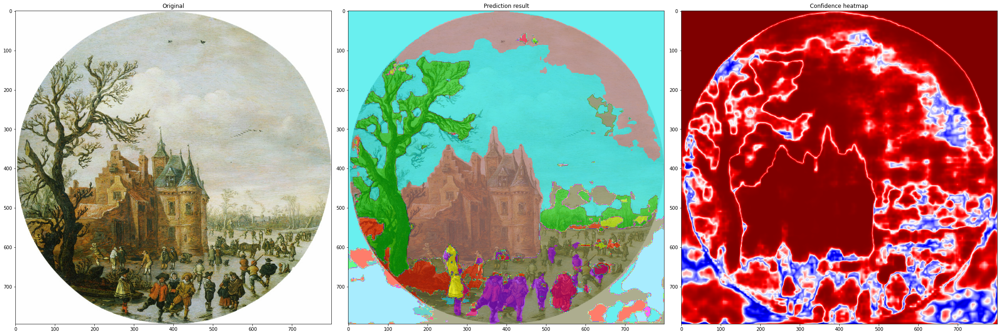

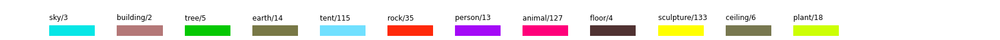

In [ ]:
visualize_prediction_and_confidence(im1_arr, res_prediction)

Note: the model predicted classes on the blank border, too.

#### ILLUSTRATION 9

In this example we make inference on a more drawing-like style

In [ ]:
im1_arr, res_prediction = end2end_prediction(wikiart_id = df_results6.iloc[1]["id"])

debug_function for  "input"  --> <class 'tensorflow.python.framework.ops.Tensor'>  | shape: [1 900 594 3]  | min: 0  | max: 255
Begin pretrained_model on: <class 'tensorflow.python.framework.ops.Tensor'> [1 513 513 3]
debug_function for  "output_logits"  --> <class 'tensorflow.python.framework.ops.Tensor'>  | shape: [1 513 513 151]  | min: -10.4652672  | max: 19.5341492
After softmax: <class 'tensorflow.python.framework.ops.Tensor'> [1 513 513]
Memorized shape: <class 'tensorflow.python.framework.ops.Tensor'> [900 594]
debug_function for  "output_segmap"  --> <class 'tensorflow.python.framework.ops.Tensor'>  | shape: [1 513 513]  | min: 1  | max: 150
resize_original_shape: <class 'tensorflow.python.framework.ops.Tensor'> [1 513 513]
resize_original_shape: <class 'tensorflow.python.framework.ops.Tensor'> [900 594]
resize_original_shape: <class 'tensorflow.python.framework.ops.Tensor'> [1 513 513]
resize_original_shape: <class 'tensorflow.python.framework.ops.Tensor'> [900 594]


In [ ]:
decode_and_compute_classes_pixels_ratios(res_prediction[0])

OrderedDict([('wall', 43.52),
             ('floor', 19.09),
             ('tree', 18.3),
             ('earth', 3.83),
             ('railing', 3.19),
             ('grass', 2.09),
             ('plant', 2.08),
             ('curtain', 0.7),
             ('mountain', 0.68),
             ('sky', 0.64),
             ('person', 0.61),
             ('water', 0.61),
             ('building', 0.57),
             ('signboard', 0.48),
             ('road', 0.46),
             ('bed', 0.33)])

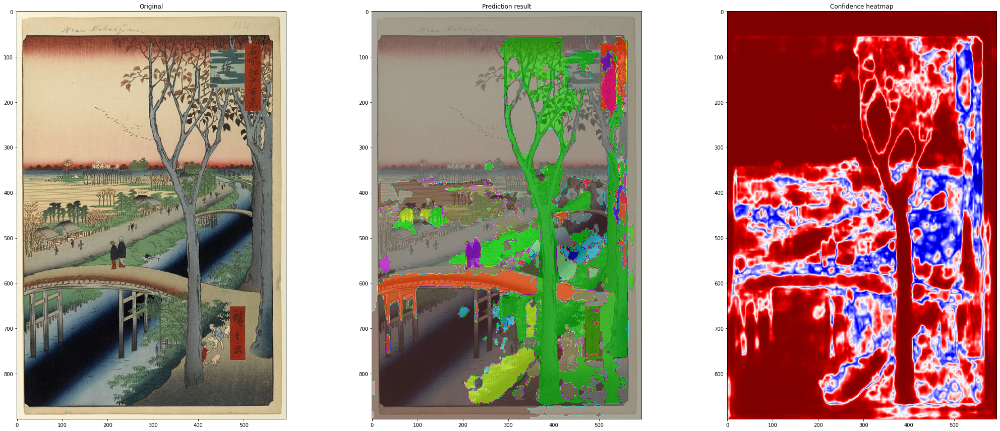

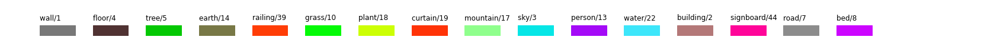

In [ ]:
visualize_prediction_and_confidence(im1_arr, res_prediction)

#### ILLUSTRATION 10

In this example we make inference on a more drawing-like style

In [ ]:
im1_arr, res_prediction = end2end_prediction(wikiart_id = df_results9.iloc[2]["id"])

debug_function for  "input"  --> <class 'tensorflow.python.framework.ops.Tensor'>  | shape: [1 2628 3961 3]  | min: 6  | max: 255
Begin pretrained_model on: <class 'tensorflow.python.framework.ops.Tensor'> [1 513 513 3]
debug_function for  "output_logits"  --> <class 'tensorflow.python.framework.ops.Tensor'>  | shape: [1 513 513 151]  | min: -9.86501  | max: 19.1288147
After softmax: <class 'tensorflow.python.framework.ops.Tensor'> [1 513 513]
Memorized shape: <class 'tensorflow.python.framework.ops.Tensor'> [2628 3961]
debug_function for  "output_segmap"  --> <class 'tensorflow.python.framework.ops.Tensor'>  | shape: [1 513 513]  | min: 1  | max: 47
resize_original_shape: <class 'tensorflow.python.framework.ops.Tensor'> [1 513 513]
resize_original_shape: <class 'tensorflow.python.framework.ops.Tensor'> [2628 3961]
resize_original_shape: <class 'tensorflow.python.framework.ops.Tensor'> [1 513 513]
resize_original_shape: <class 'tensorflow.python.framework.ops.Tensor'> [2628 3961]


In [ ]:
decode_and_compute_classes_pixels_ratios(res_prediction[0])

OrderedDict([('building', 43.04),
             ('earth', 22.24),
             ('tree', 13.24),
             ('sand', 10.6),
             ('wall', 6.79),
             ('floor', 1.19),
             ('sky', 0.45),
             ('plant', 0.44)])

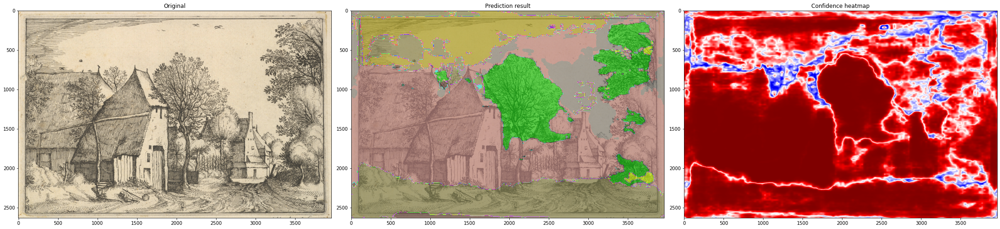

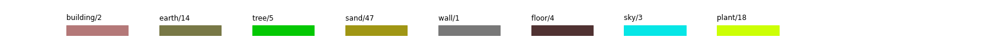

In [ ]:
visualize_prediction_and_confidence(im1_arr, res_prediction)